<a href="https://colab.research.google.com/github/DSGPproject/DSGP_model/blob/main/TESTING_ACCURACY.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#this is importing the stuff

import tensorflow as tf
from tensorflow.keras import models, layers
import matplotlib.pyplot as plt
from IPython.display import HTML

import tensorflow.keras as tfk
import tensorflow.keras.layers as tfl

import matplotlib.pyplot as plt

import numpy as np

%load_ext tensorboard

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
BATCH_SIZE = 32
IMAGE_SIZE = 256
CHANNELS=3
EPOCHS=25

# ***Importing dataset***

> Add blockquote



In [ ]:
dataset = tf.keras.preprocessing.image_dataset_from_directory( #loading the dataset
     "/content/drive/MyDrive/dataset/unchanged",
    seed=123,
    shuffle = True,
    image_size = (IMAGE_SIZE,IMAGE_SIZE),
    batch_size = BATCH_SIZE
)
class_names = dataset.class_names
class_names

Found 886 files belonging to 8 classes.


['Anthracnose',
 'algal leaf',
 'bird eye spot',
 'brown blight',
 'gray light',
 'healthy',
 'red leaf spot',
 'white spot']

# **Splitting dataset**

In [ ]:
def get_dataset_partitions_tf(ds, train_split=0.8, val_split=0.1, test_split=0.1, shuffle=True, shuffle_size=10000):
    assert (train_split + test_split + val_split) == 1

    ds_size = len(ds)
    if shuffle:
        ds = ds.shuffle(shuffle_size, seed=12)

    train_size = int(train_split * ds_size)
    val_size = int(val_split * ds_size)

    train_ds = ds.take(train_size)
    val_ds = ds.skip(train_size).take(val_size)
    test_ds = ds.skip(train_size + val_size)

    return train_ds, val_ds, test_ds
#---------------------------------------------------

#getting the 3 things
train_ds, val_ds, test_ds = get_dataset_partitions_tf(dataset)


train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)
val_ds = val_ds.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)
test_ds = test_ds.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)


# ***Loaded model***

In [ ]:

# Replace 'your_model_path' with the actual path where your model is saved
model_path = "/content/drive/MyDrive/colab_NoteBooks/withauglittle_only basic aug good 3rd model from scratch_decayrate_learning_rate_adamax"

# Load the model
loaded_model = tf.keras.models.load_model(model_path)

# ***Getting predictions to test model maunally***

1/1 [==============================] - 0s 405ms/step


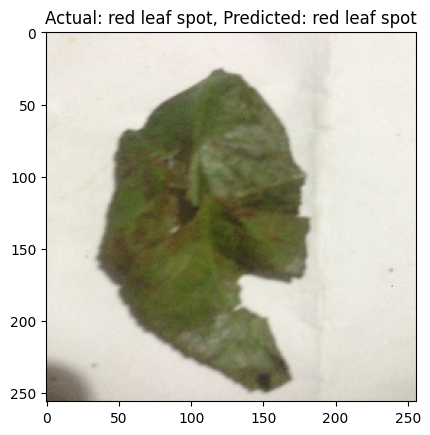

1/1 [==============================] - 0s 77ms/step


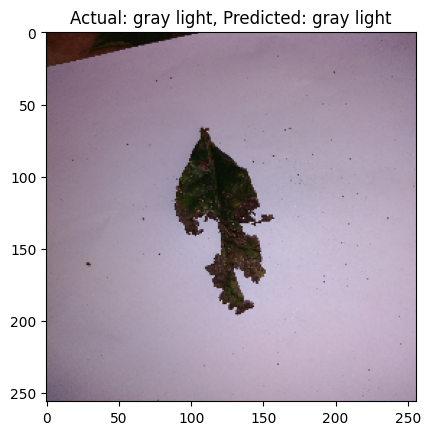

1/1 [==============================] - 0s 63ms/step


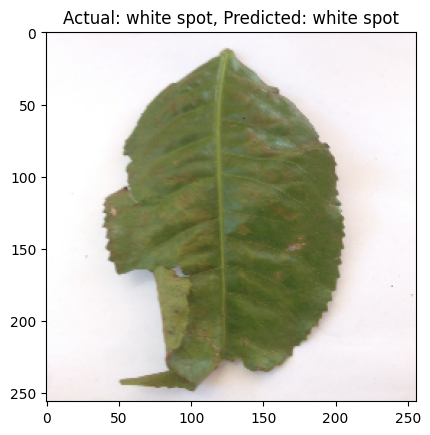

1/1 [==============================] - 0s 75ms/step


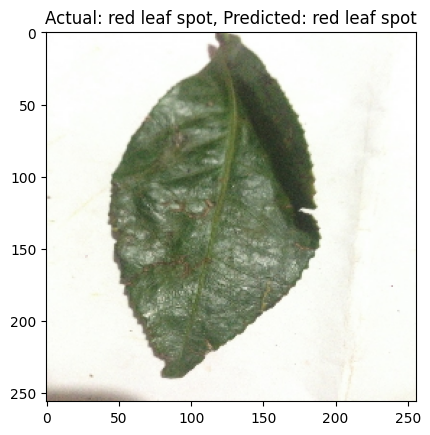

1/1 [==============================] - 0s 84ms/step


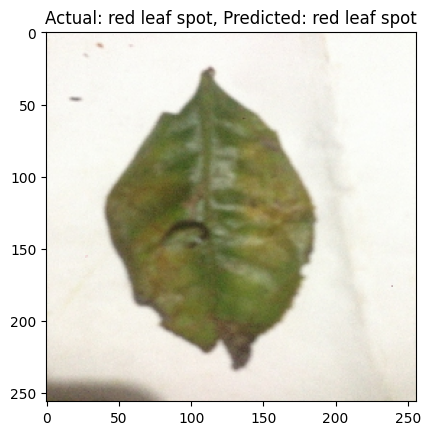

1/1 [==============================] - 0s 129ms/step


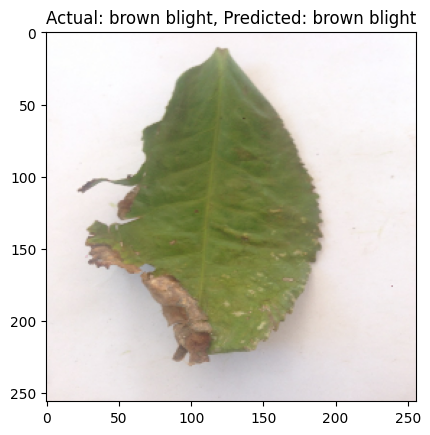

1/1 [==============================] - 0s 108ms/step


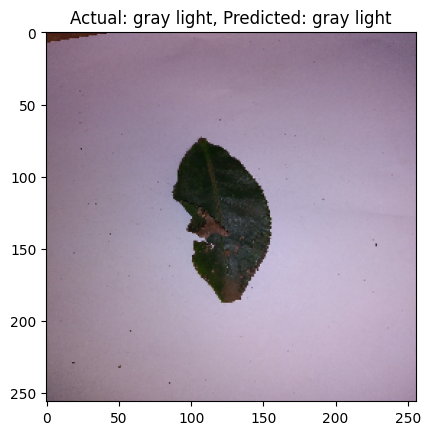

1/1 [==============================] - 0s 105ms/step


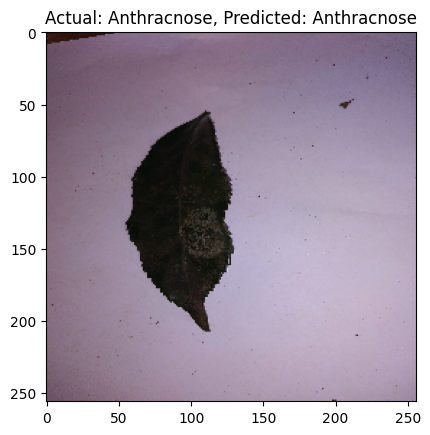

1/1 [==============================] - 0s 110ms/step


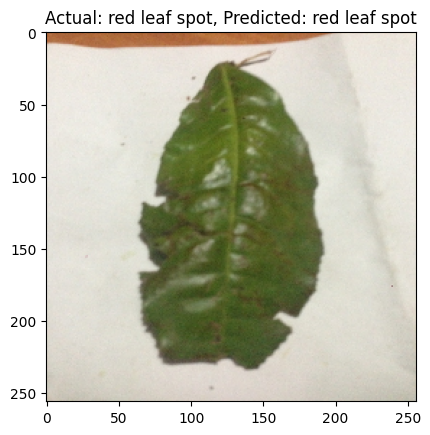

1/1 [==============================] - 0s 118ms/step


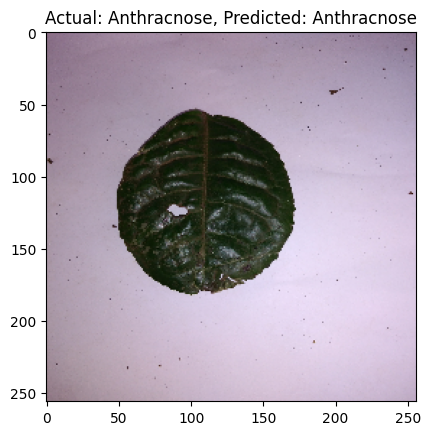

1/1 [==============================] - 0s 102ms/step


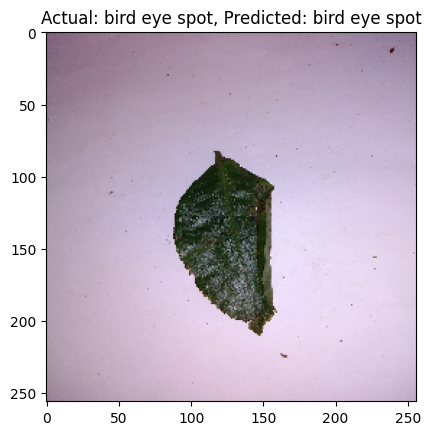

1/1 [==============================] - 0s 113ms/step


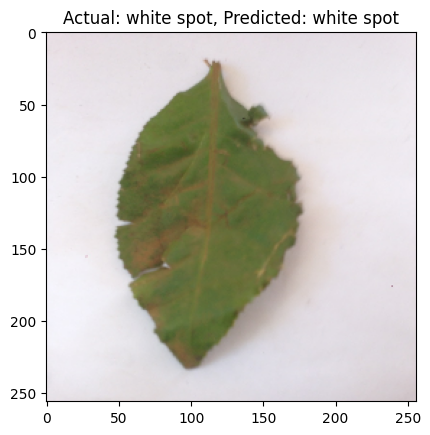

1/1 [==============================] - 0s 63ms/step


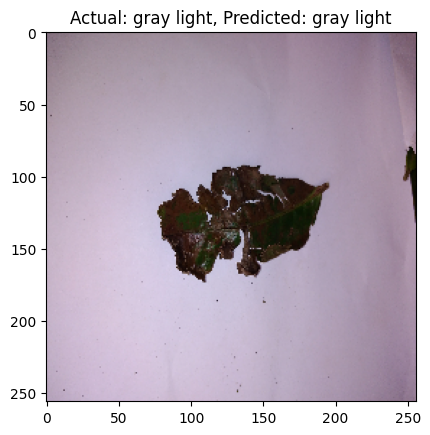

1/1 [==============================] - 0s 68ms/step


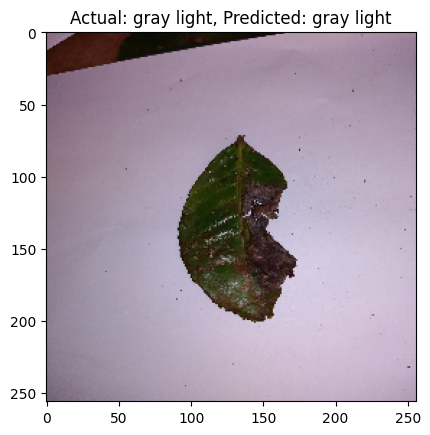

1/1 [==============================] - 0s 72ms/step


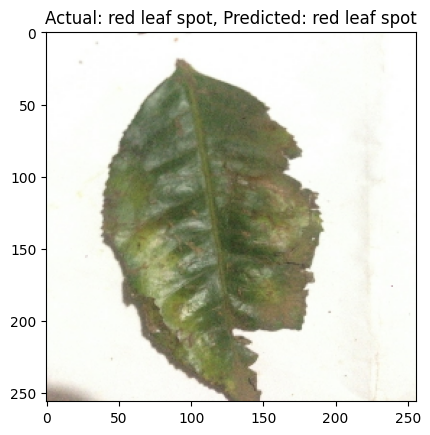

1/1 [==============================] - 0s 71ms/step


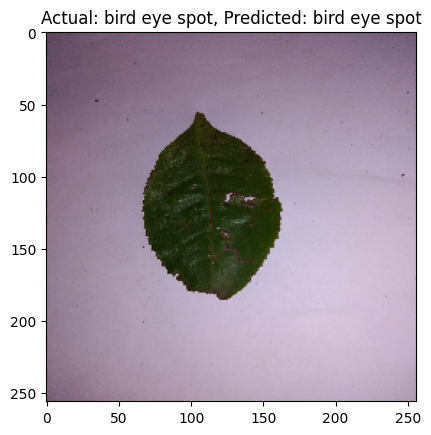

1/1 [==============================] - 0s 149ms/step


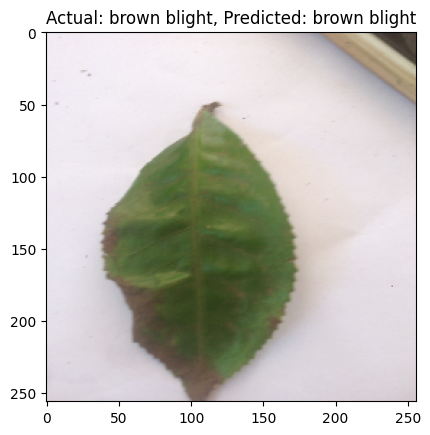

1/1 [==============================] - 0s 206ms/step


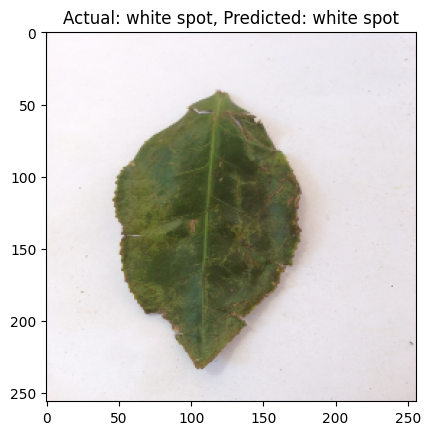

1/1 [==============================] - 0s 81ms/step


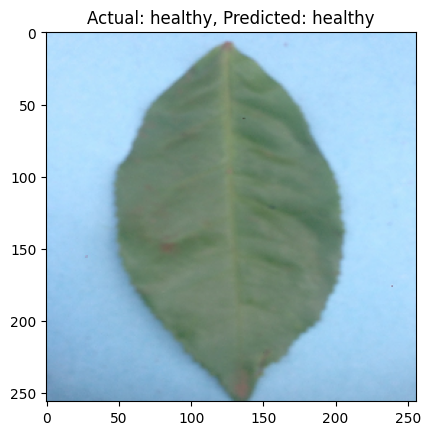

1/1 [==============================] - 0s 90ms/step


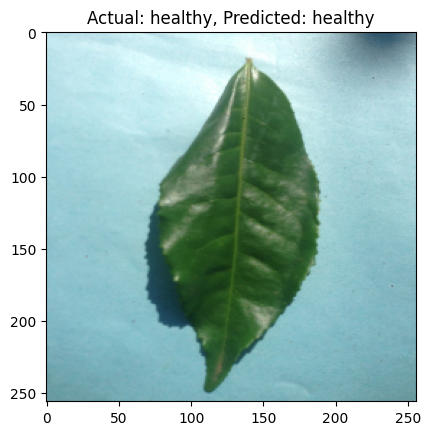

1/1 [==============================] - 0s 83ms/step


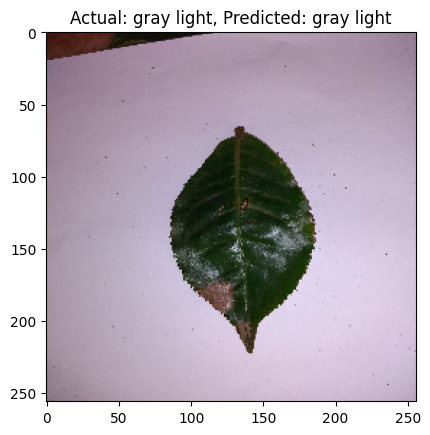

1/1 [==============================] - 0s 79ms/step


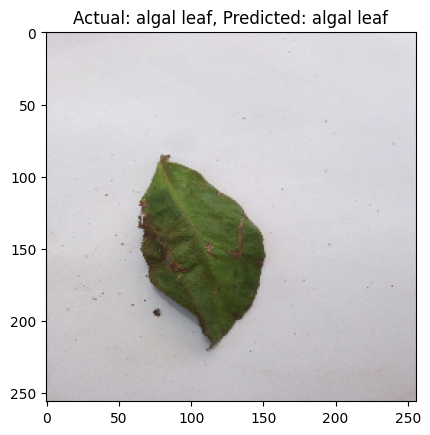

1/1 [==============================] - 0s 87ms/step


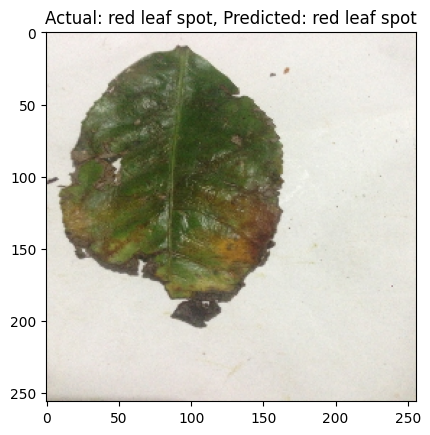

1/1 [==============================] - 0s 83ms/step


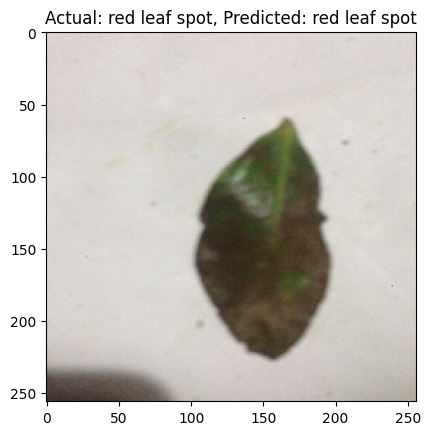

1/1 [==============================] - 0s 82ms/step


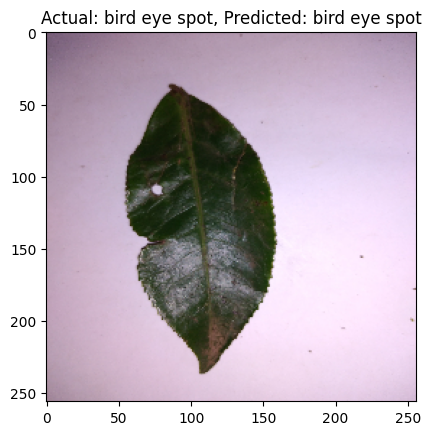

1/1 [==============================] - 0s 84ms/step


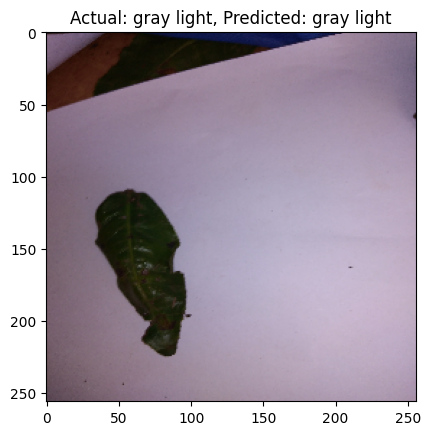

1/1 [==============================] - 0s 83ms/step


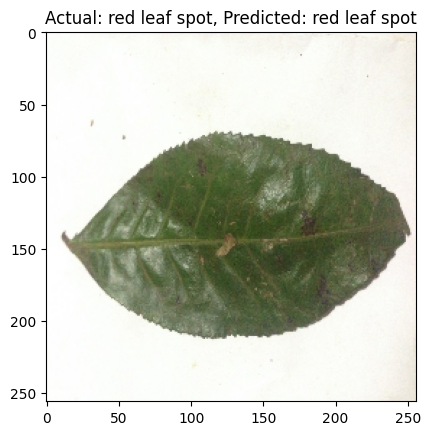

1/1 [==============================] - 0s 92ms/step


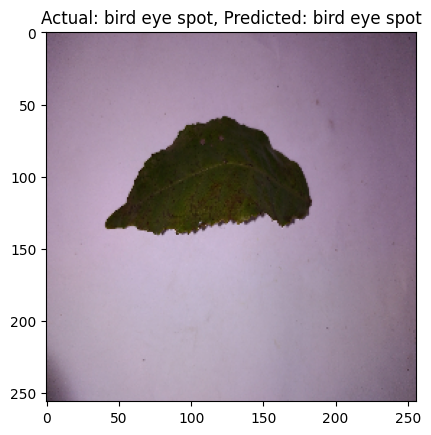

1/1 [==============================] - 0s 88ms/step


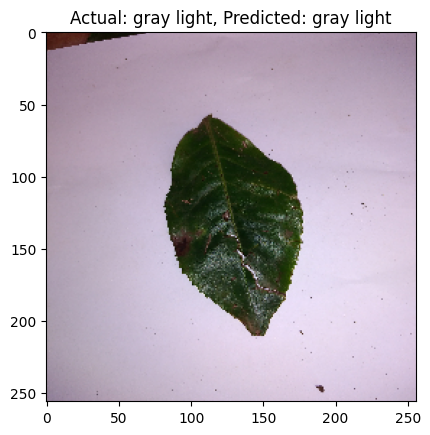

1/1 [==============================] - 0s 158ms/step


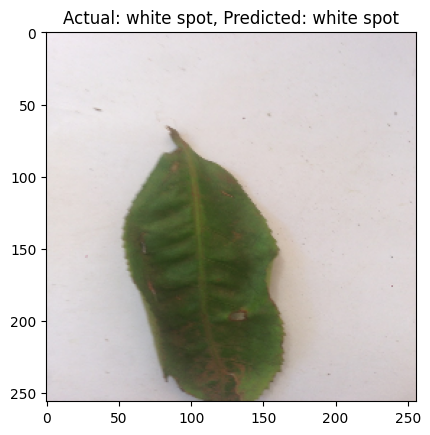

1/1 [==============================] - 0s 144ms/step


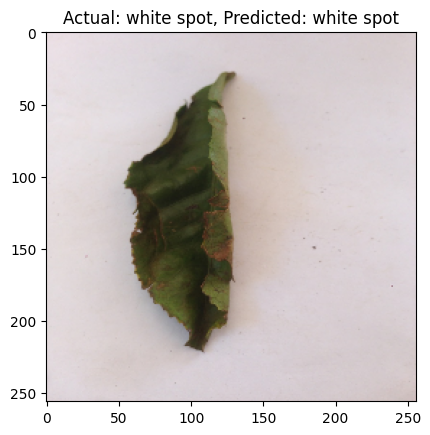

1/1 [==============================] - 0s 131ms/step


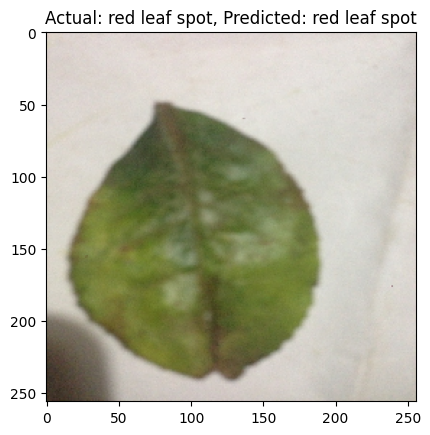

1/1 [==============================] - 0s 106ms/step


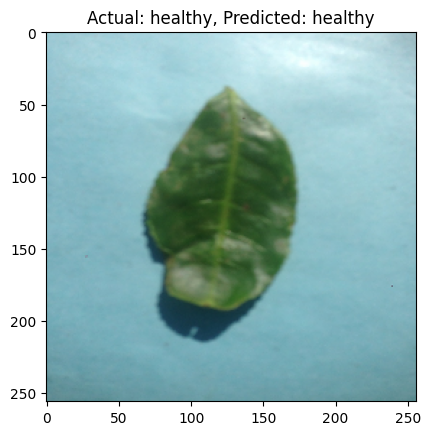

1/1 [==============================] - 0s 102ms/step


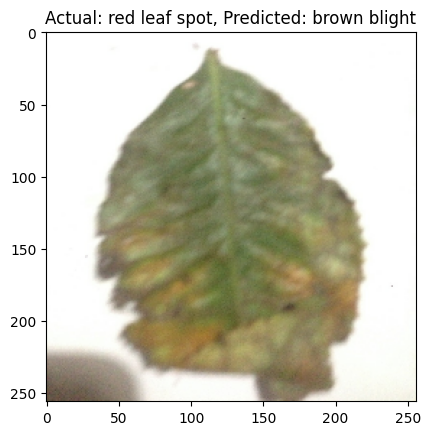

1/1 [==============================] - 0s 105ms/step


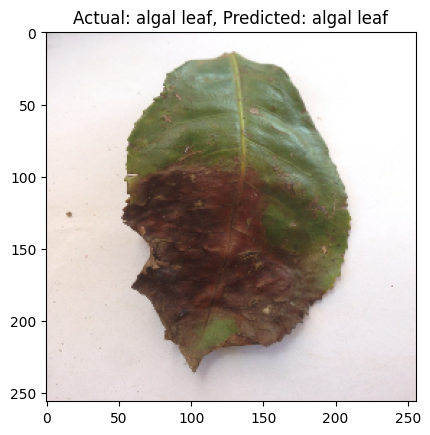

1/1 [==============================] - 0s 118ms/step


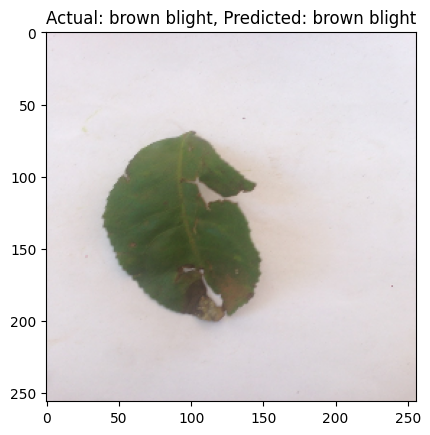

1/1 [==============================] - 0s 138ms/step


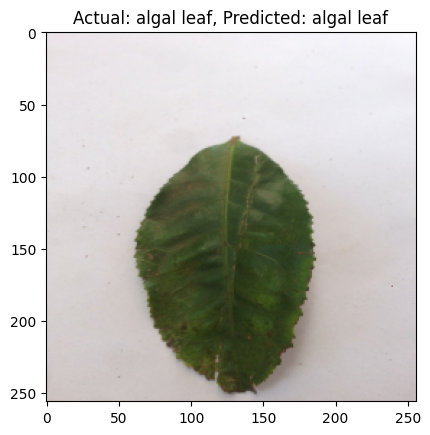

1/1 [==============================] - 0s 139ms/step


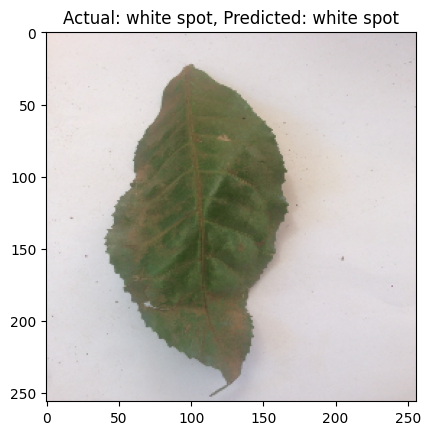

1/1 [==============================] - 0s 152ms/step


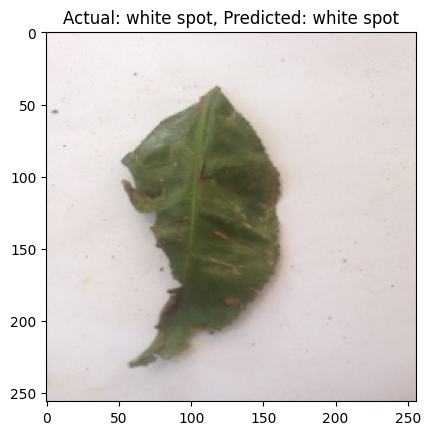

1/1 [==============================] - 0s 152ms/step


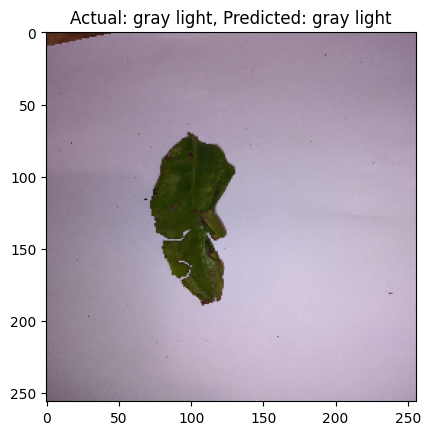

1/1 [==============================] - 0s 101ms/step


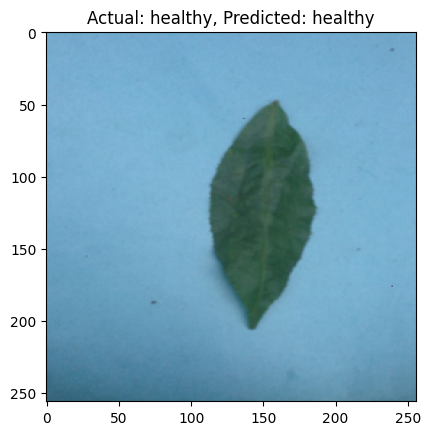

1/1 [==============================] - 0s 100ms/step


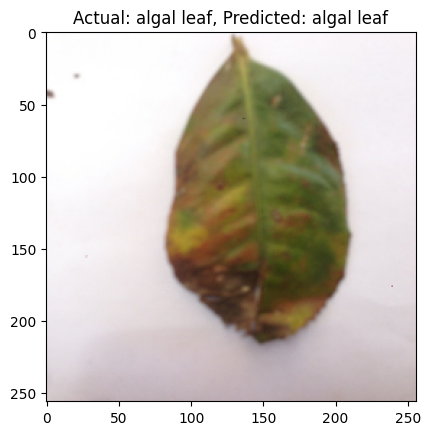

1/1 [==============================] - 0s 98ms/step


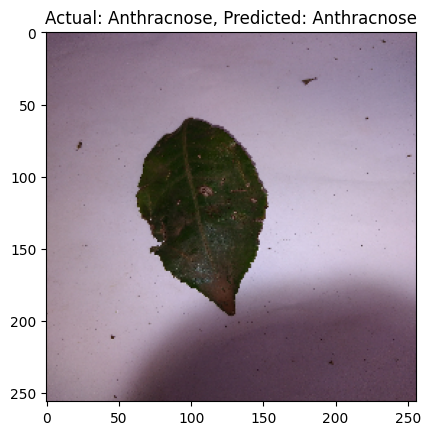

1/1 [==============================] - 0s 110ms/step


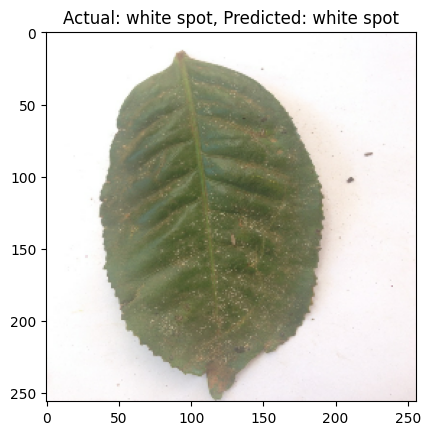

1/1 [==============================] - 0s 101ms/step


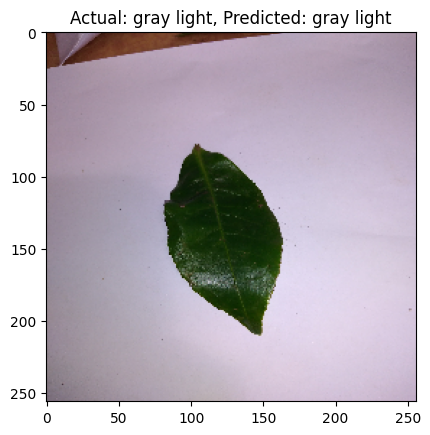

1/1 [==============================] - 0s 104ms/step


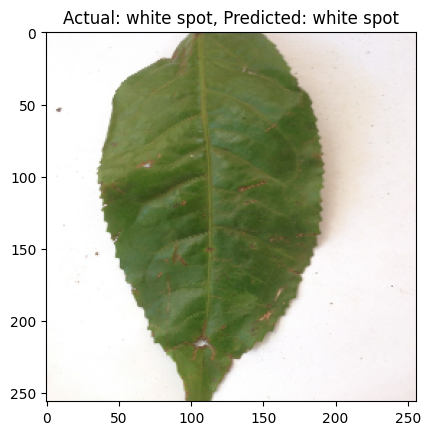

1/1 [==============================] - 0s 102ms/step


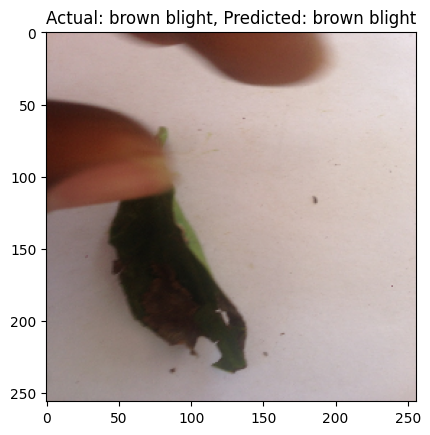

1/1 [==============================] - 0s 99ms/step


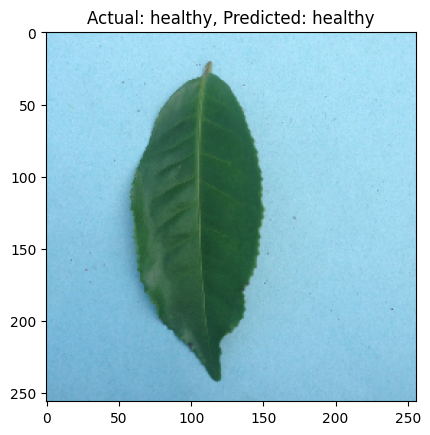

1/1 [==============================] - 0s 112ms/step


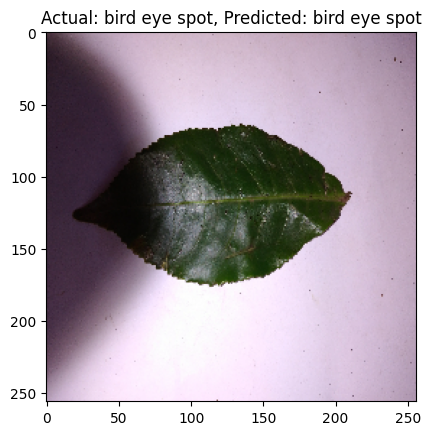

1/1 [==============================] - 0s 100ms/step


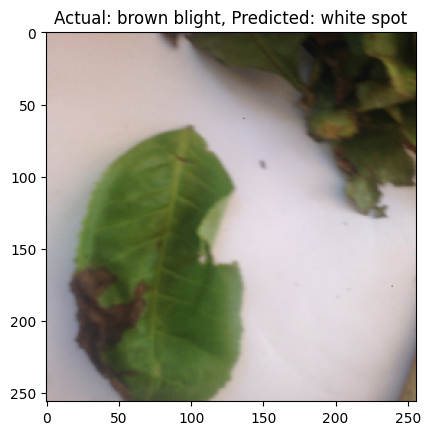

1/1 [==============================] - 0s 98ms/step


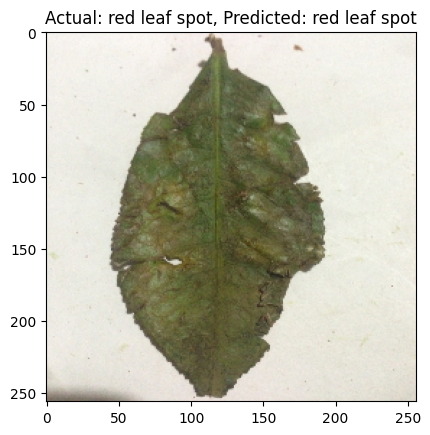

1/1 [==============================] - 0s 102ms/step


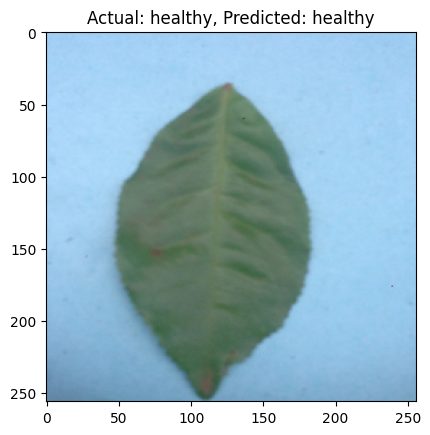

1/1 [==============================] - 0s 96ms/step


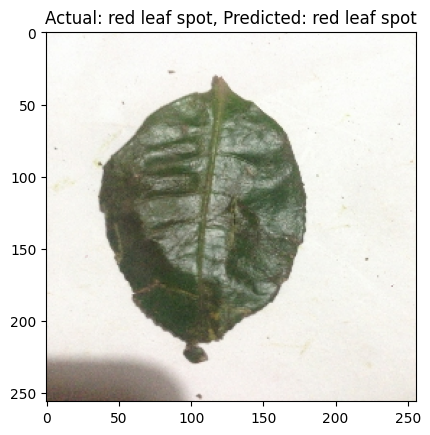

1/1 [==============================] - 0s 110ms/step


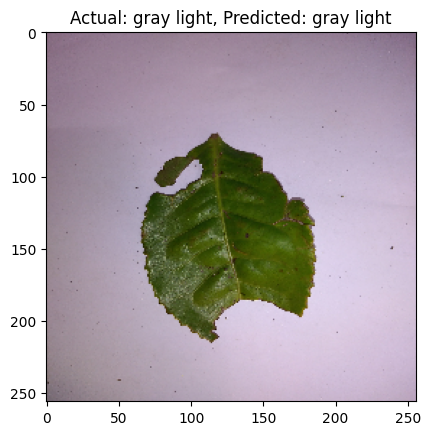

1/1 [==============================] - 0s 100ms/step


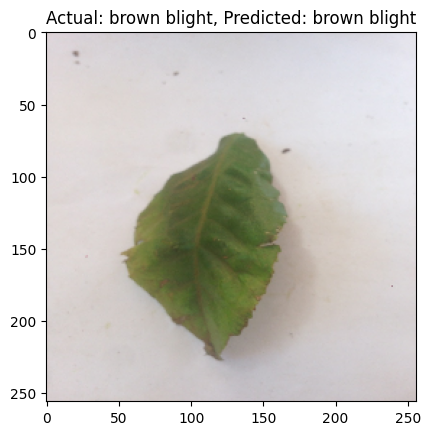

1/1 [==============================] - 0s 112ms/step


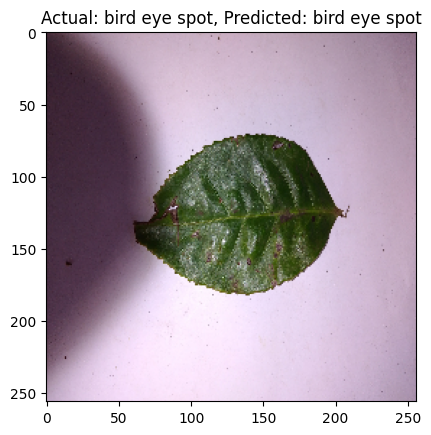

1/1 [==============================] - 0s 110ms/step


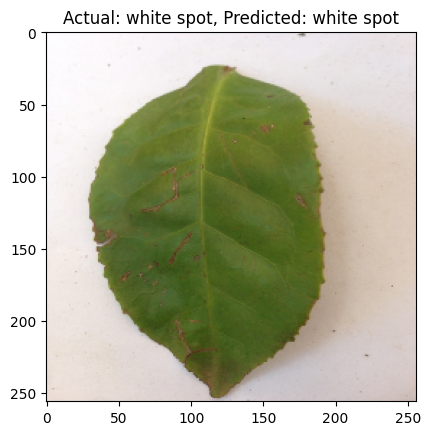

1/1 [==============================] - 0s 100ms/step


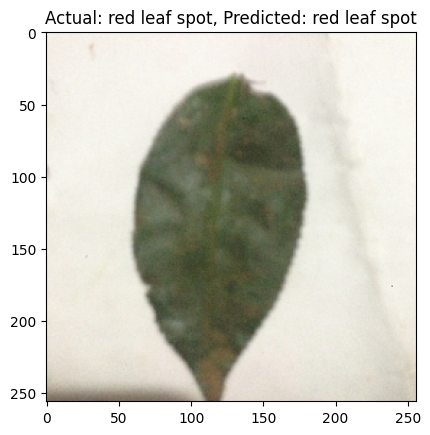

1/1 [==============================] - 0s 105ms/step


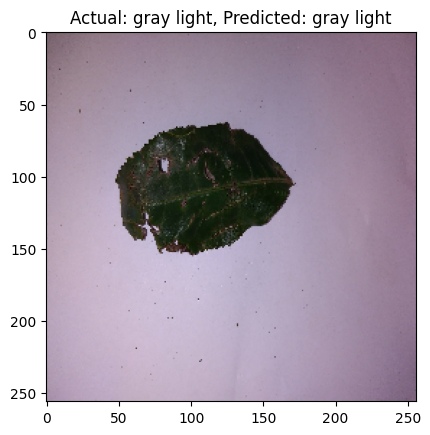

1/1 [==============================] - 0s 103ms/step


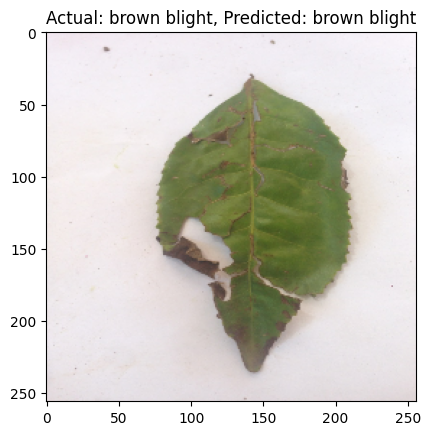

1/1 [==============================] - 0s 99ms/step


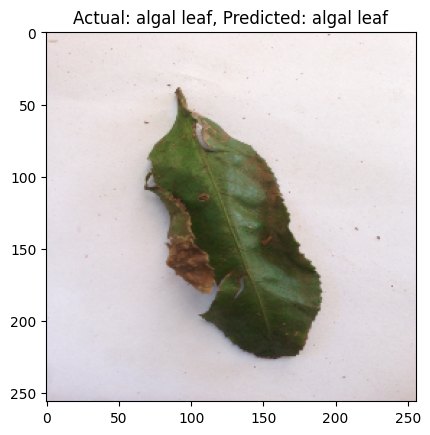

1/1 [==============================] - 0s 102ms/step


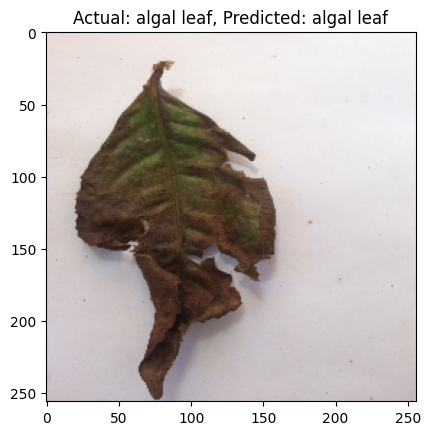

1/1 [==============================] - 0s 99ms/step


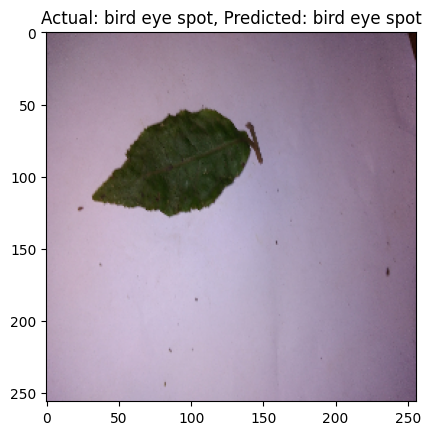

1/1 [==============================] - 0s 104ms/step


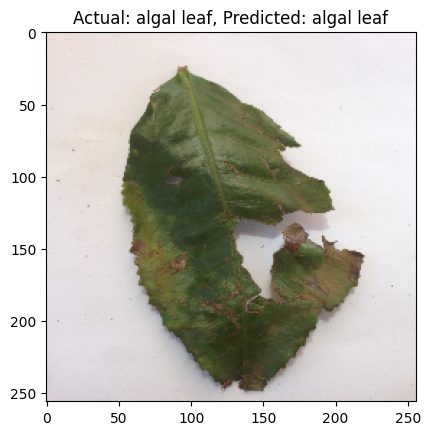

In [ ]:
def visualize_predictions(dataset, model):
    for images_batch, labels_batch in dataset:
        for i in range(len(images_batch)):
            image = images_batch[i].numpy().astype('uint8')
            actual_label = labels_batch[i].numpy()

            # Reshape the image to (1, height, width, channels) for prediction
            image_for_prediction = np.expand_dims(image, axis=0)

            # Make predictions
            predictions = model.predict(image_for_prediction)
            predicted_label = np.argmax(predictions[0])

            # Display the image and labels
            plt.imshow(image)
            plt.title(f"Actual: {class_names[actual_label]}, Predicted: {class_names[predicted_label]}")
            plt.show()


visualize_predictions(val_ds, loaded_model)

# **running predictions on the testing data to check**

1/1 [==============================] - 0s 66ms/step


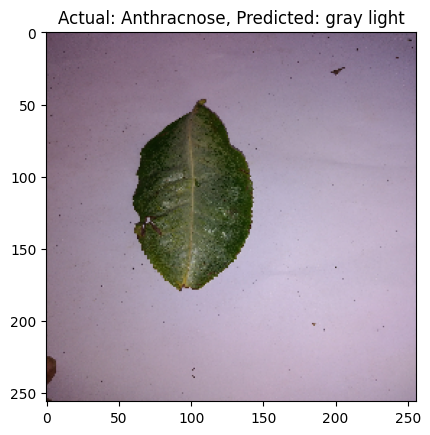

1/1 [==============================] - 0s 66ms/step


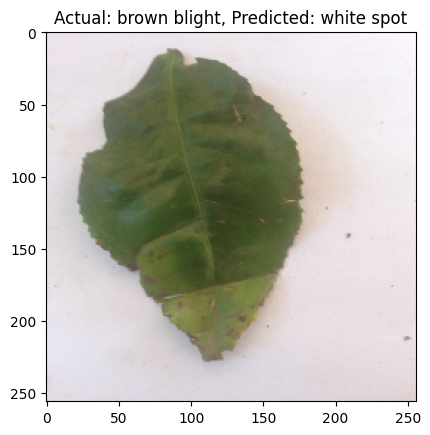

1/1 [==============================] - 0s 63ms/step


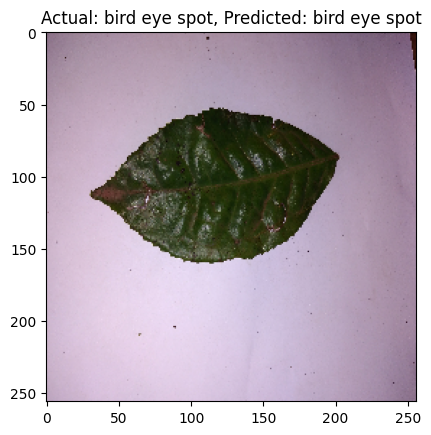

1/1 [==============================] - 0s 67ms/step


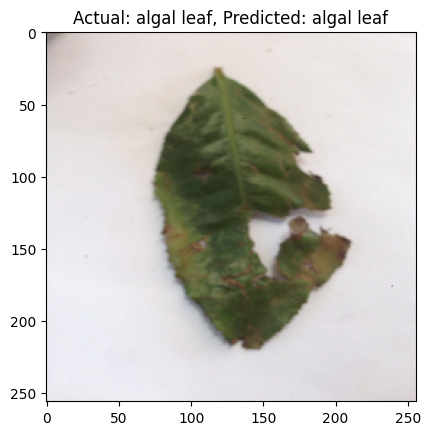

1/1 [==============================] - 0s 64ms/step


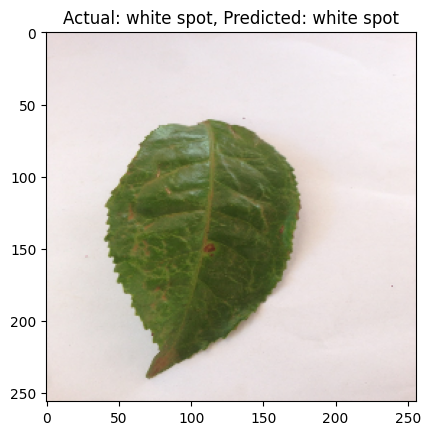

1/1 [==============================] - 0s 62ms/step


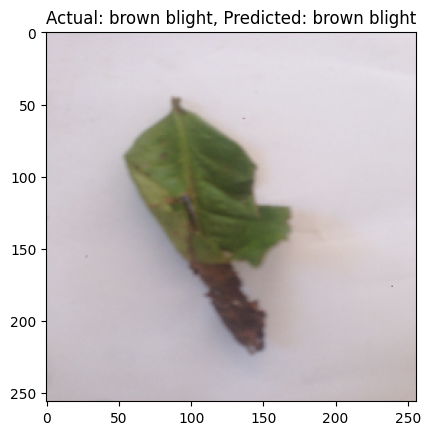

1/1 [==============================] - 0s 62ms/step


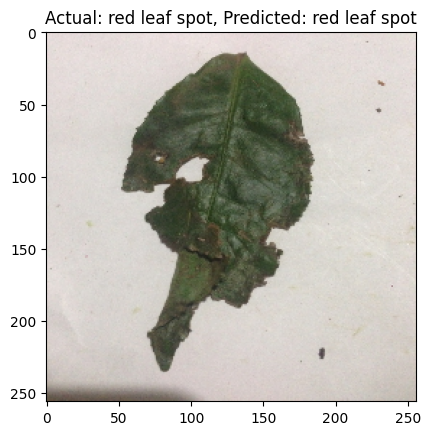

1/1 [==============================] - 0s 75ms/step


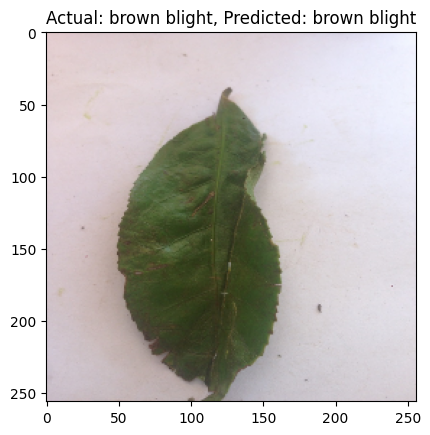

1/1 [==============================] - 0s 88ms/step


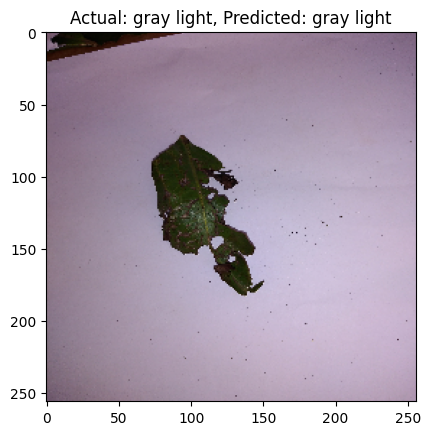

1/1 [==============================] - 0s 63ms/step


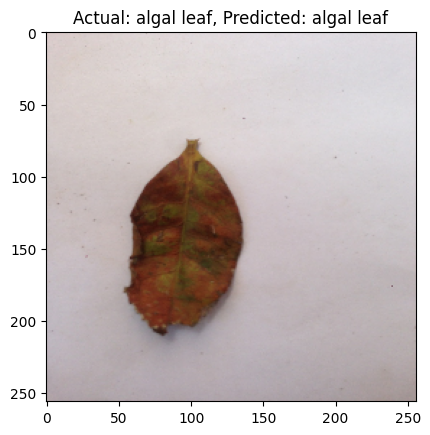

1/1 [==============================] - 0s 65ms/step


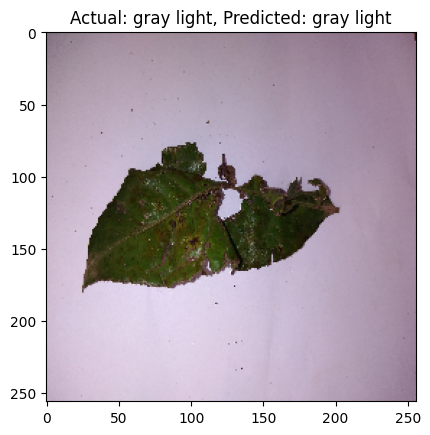

1/1 [==============================] - 0s 68ms/step


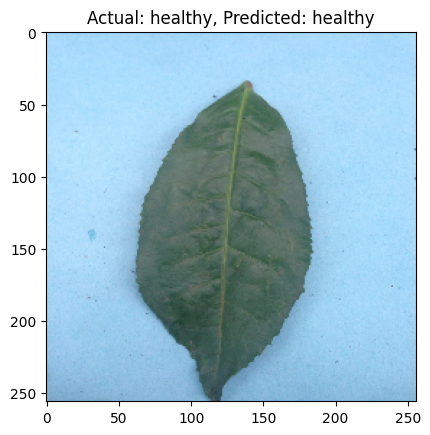

1/1 [==============================] - 0s 73ms/step


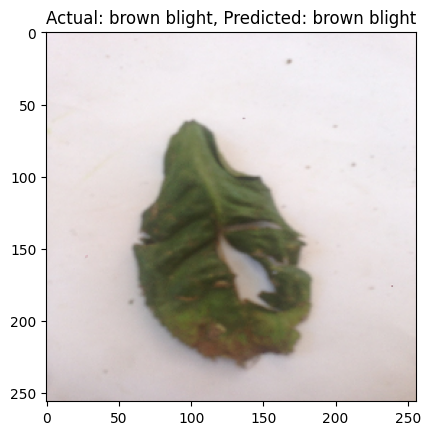

1/1 [==============================] - 0s 76ms/step


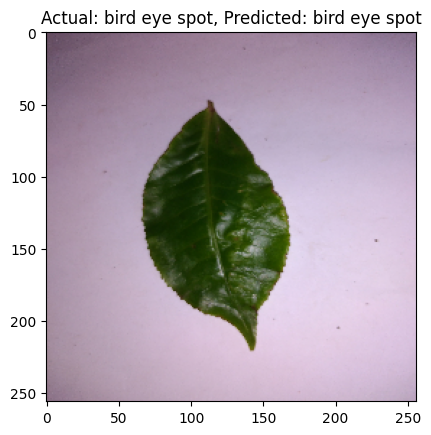

1/1 [==============================] - 0s 69ms/step


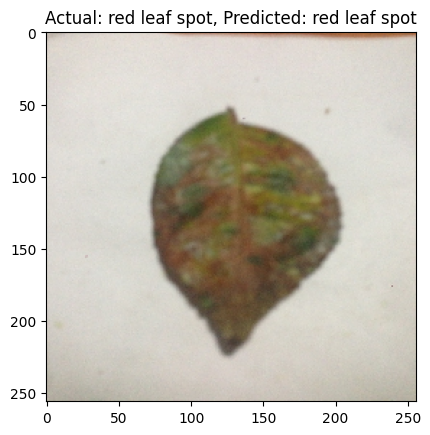

1/1 [==============================] - 0s 78ms/step


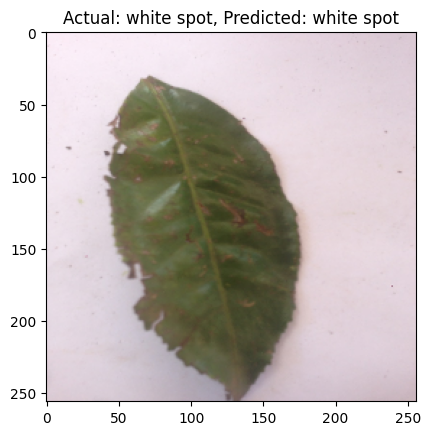

1/1 [==============================] - 0s 70ms/step


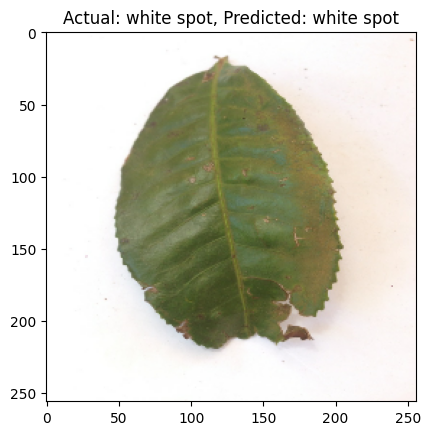

1/1 [==============================] - 0s 83ms/step


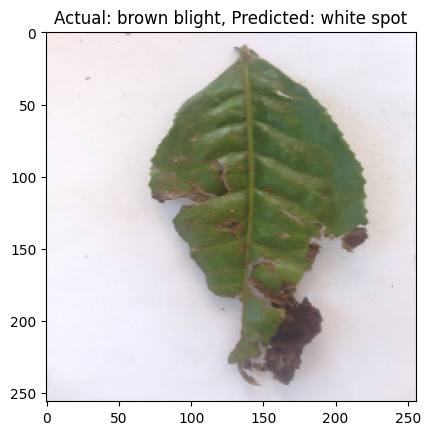

1/1 [==============================] - 0s 82ms/step


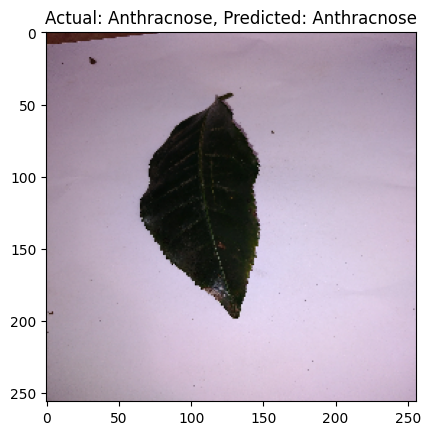

1/1 [==============================] - 0s 119ms/step


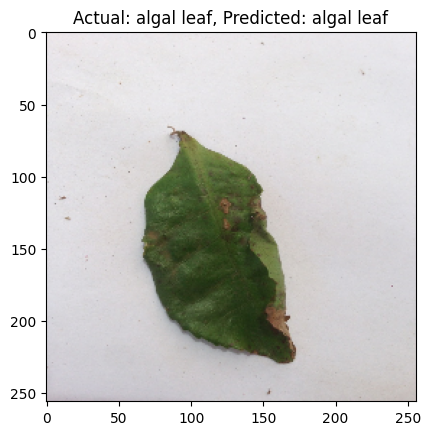

1/1 [==============================] - 0s 133ms/step


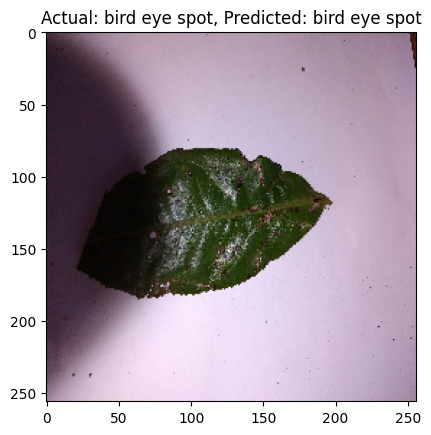

1/1 [==============================] - 0s 107ms/step


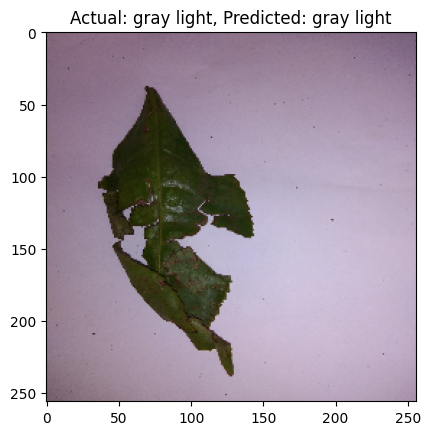

1/1 [==============================] - 0s 106ms/step


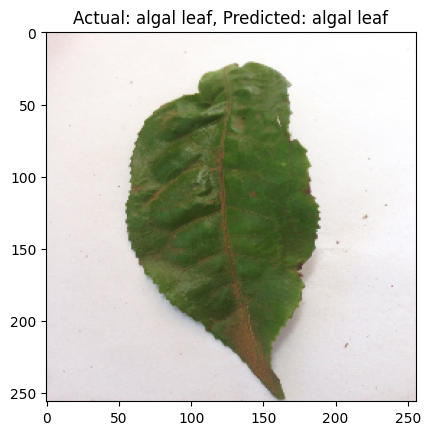

1/1 [==============================] - 0s 137ms/step


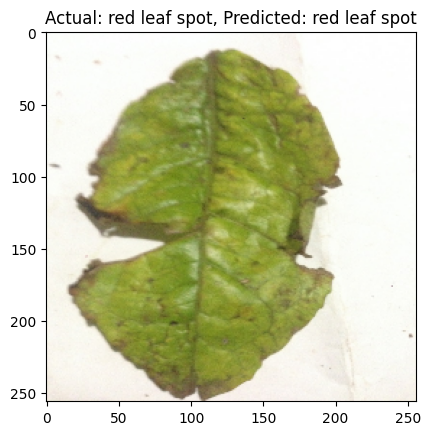

1/1 [==============================] - 0s 118ms/step


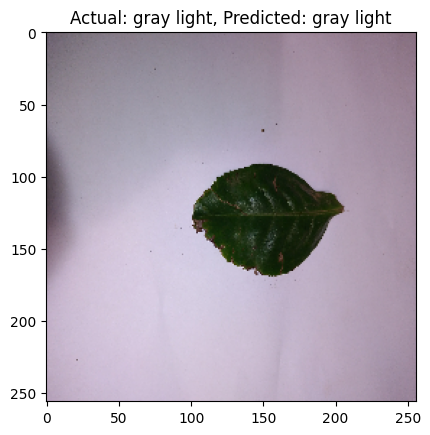

1/1 [==============================] - 0s 145ms/step


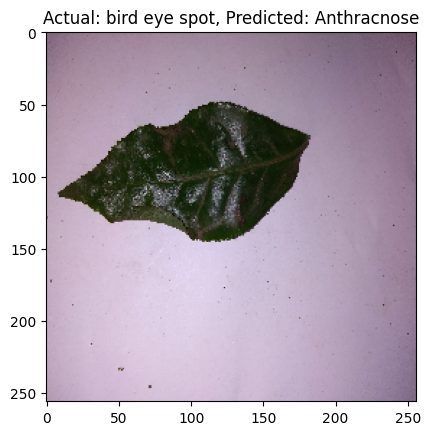

1/1 [==============================] - 0s 128ms/step


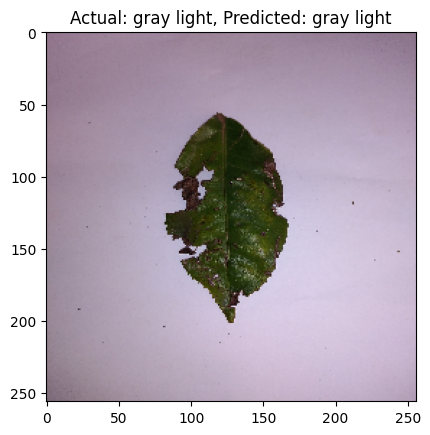

1/1 [==============================] - 0s 93ms/step


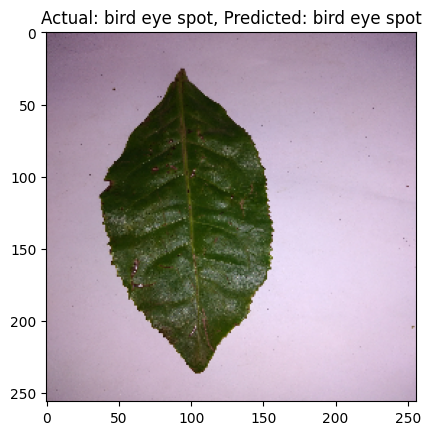

1/1 [==============================] - 0s 93ms/step


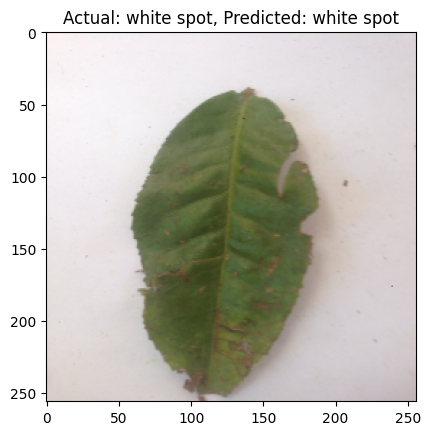

1/1 [==============================] - 0s 113ms/step


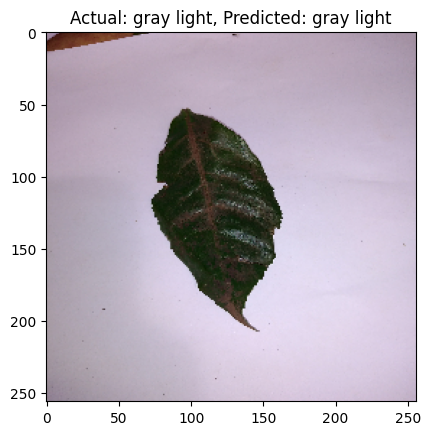

1/1 [==============================] - 0s 95ms/step


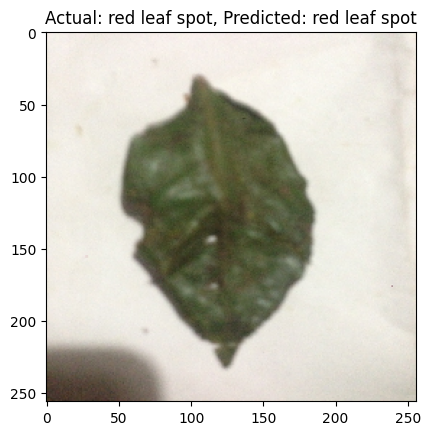

1/1 [==============================] - 0s 107ms/step


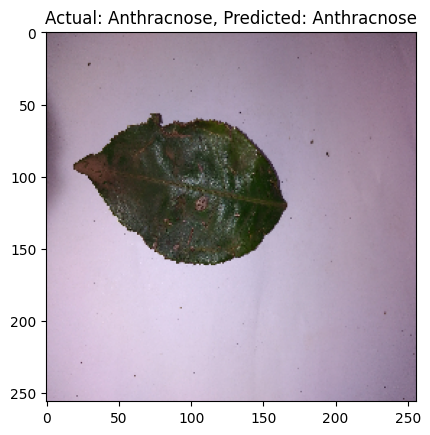

1/1 [==============================] - 0s 95ms/step


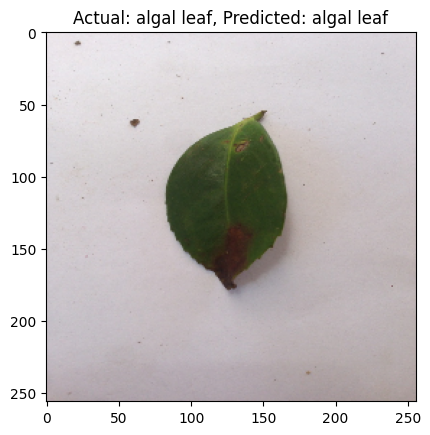

1/1 [==============================] - 0s 114ms/step


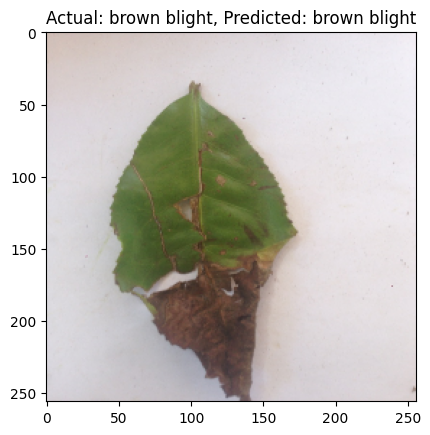

1/1 [==============================] - 0s 98ms/step


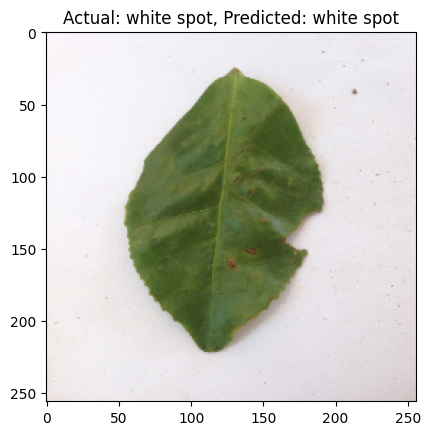

1/1 [==============================] - 0s 113ms/step


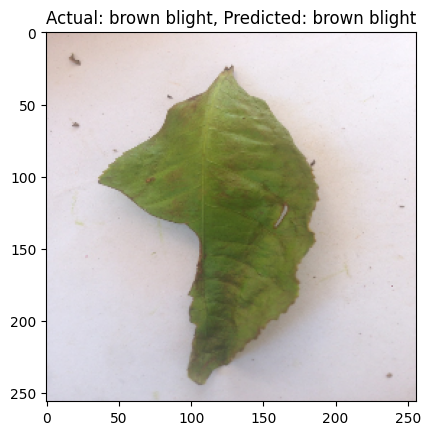

1/1 [==============================] - 0s 102ms/step


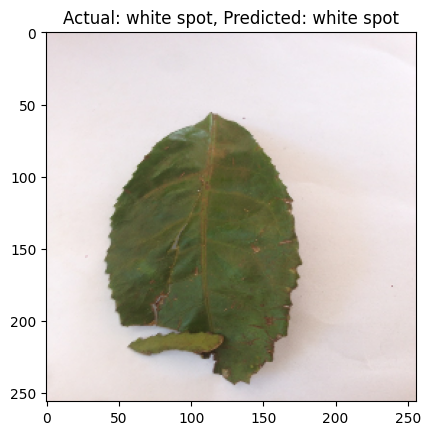

1/1 [==============================] - 0s 100ms/step


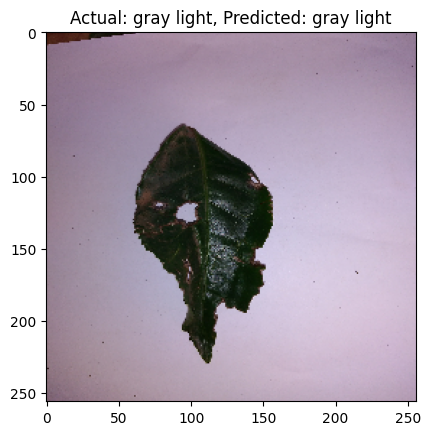

1/1 [==============================] - 0s 94ms/step


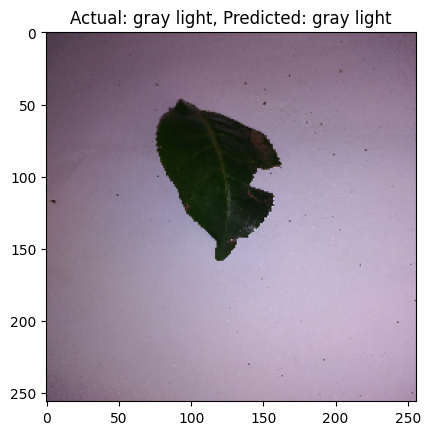

1/1 [==============================] - 0s 102ms/step


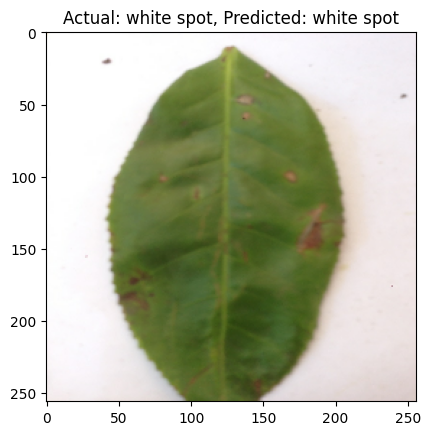

1/1 [==============================] - 0s 100ms/step


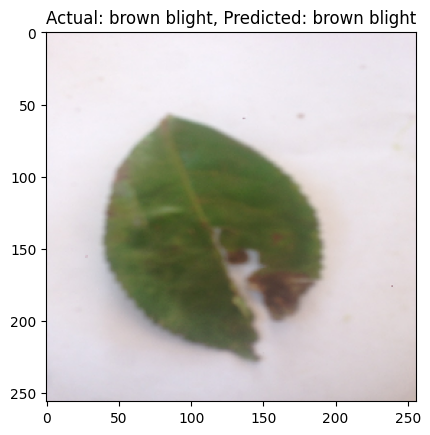

1/1 [==============================] - 0s 104ms/step


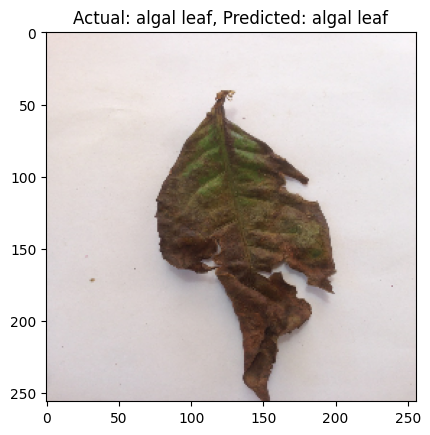

1/1 [==============================] - 0s 114ms/step


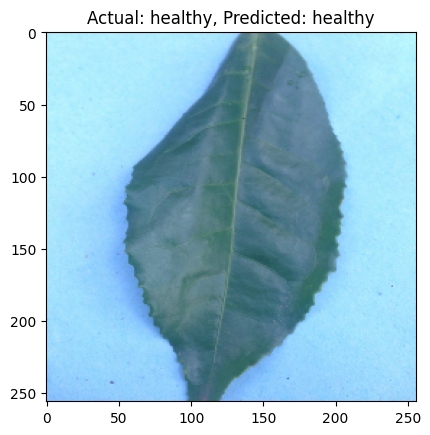

1/1 [==============================] - 0s 103ms/step


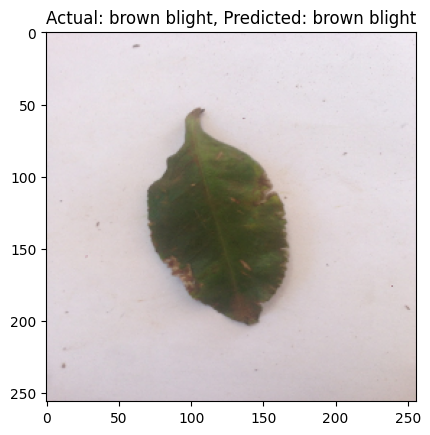

1/1 [==============================] - 0s 129ms/step


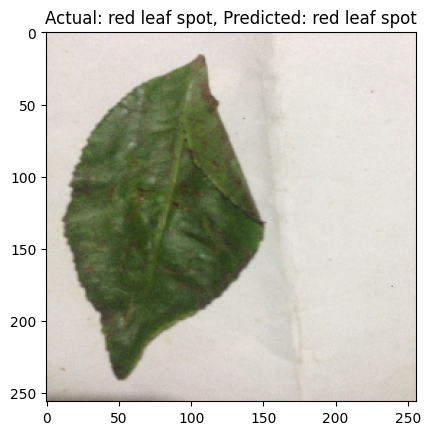

1/1 [==============================] - 0s 170ms/step


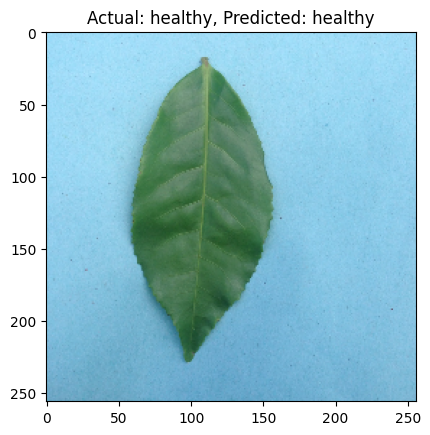

1/1 [==============================] - 0s 142ms/step


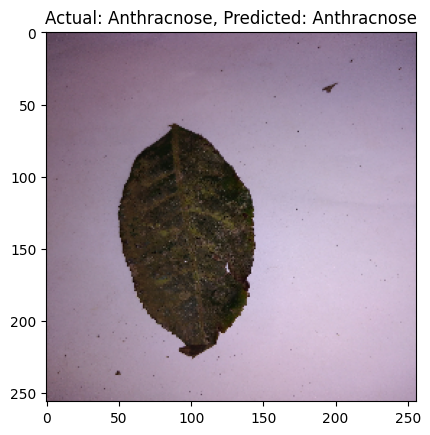

1/1 [==============================] - 0s 135ms/step


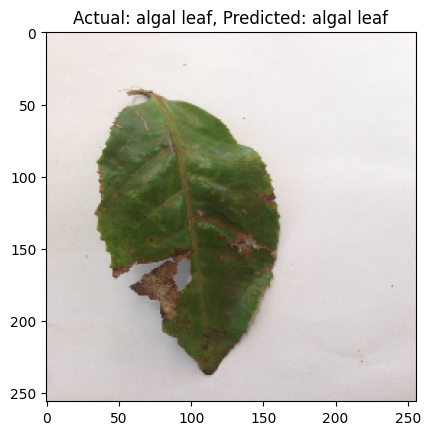

1/1 [==============================] - 0s 143ms/step


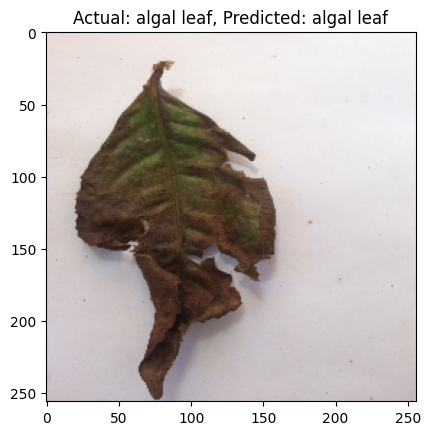

1/1 [==============================] - 0s 136ms/step


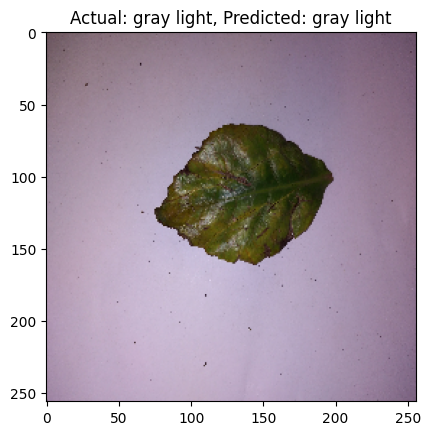

1/1 [==============================] - 0s 173ms/step


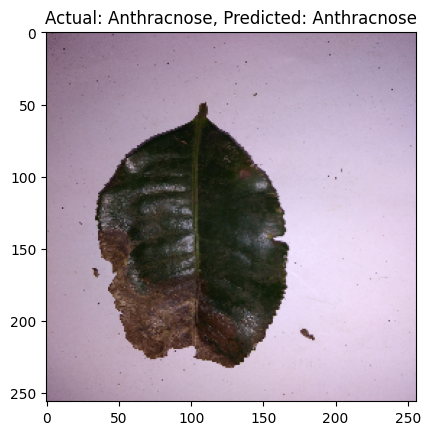

1/1 [==============================] - 0s 120ms/step


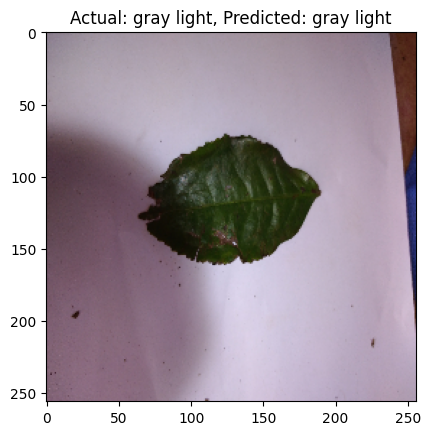

1/1 [==============================] - 0s 150ms/step


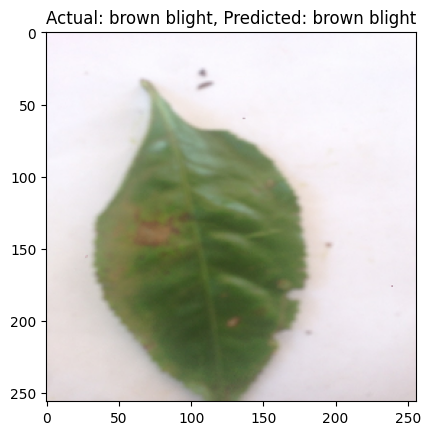

1/1 [==============================] - 0s 113ms/step


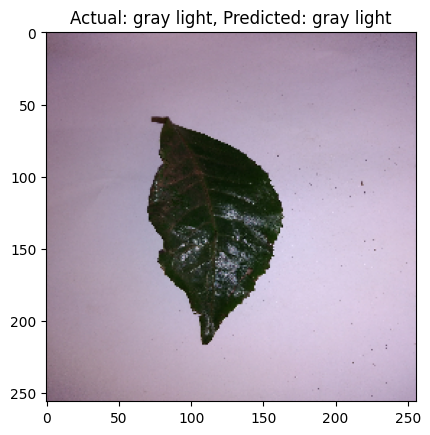

1/1 [==============================] - 0s 108ms/step


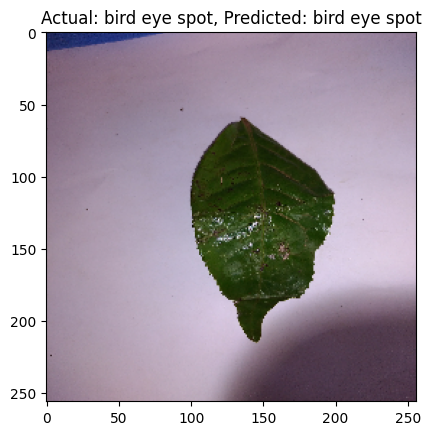

1/1 [==============================] - 0s 123ms/step


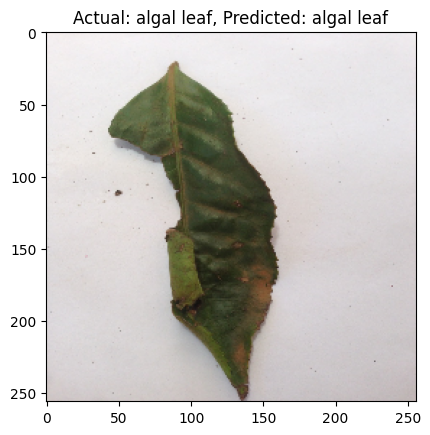

1/1 [==============================] - 0s 109ms/step


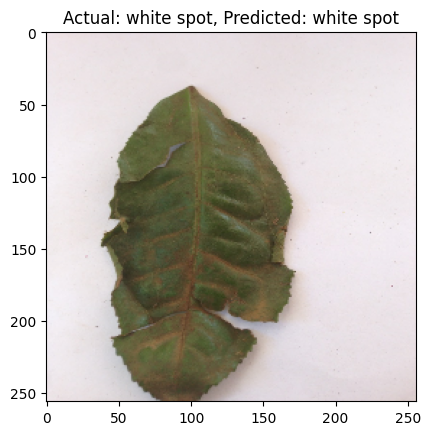

1/1 [==============================] - 0s 106ms/step


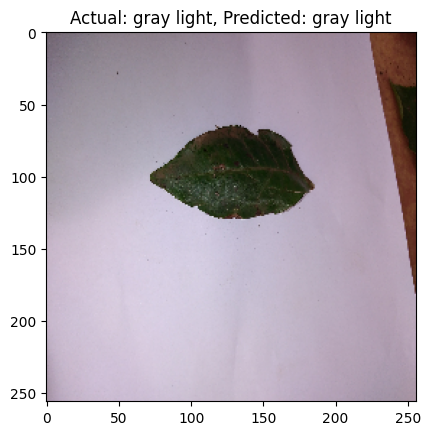

1/1 [==============================] - 0s 104ms/step


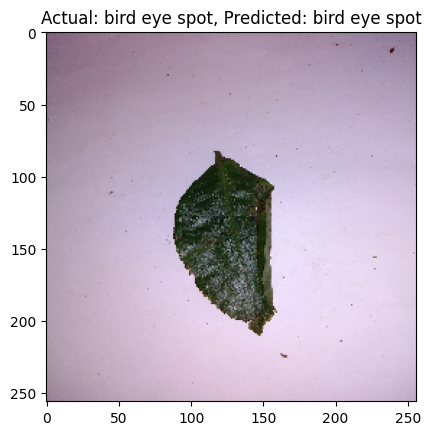

1/1 [==============================] - 0s 107ms/step


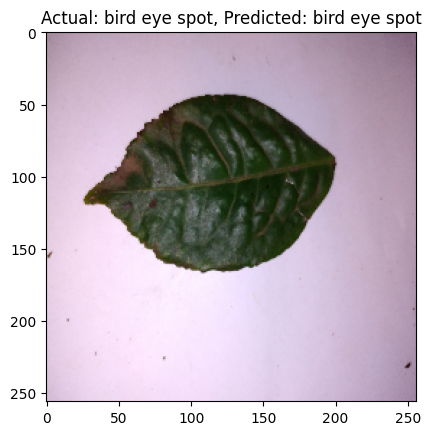

1/1 [==============================] - 0s 108ms/step


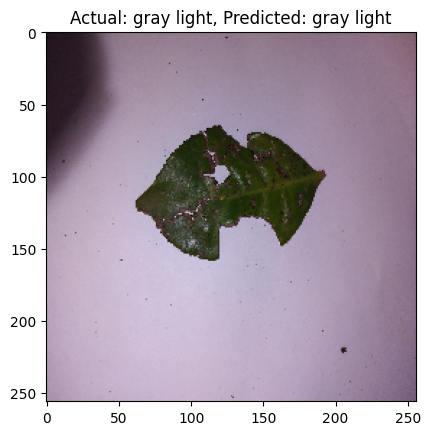

1/1 [==============================] - 0s 106ms/step


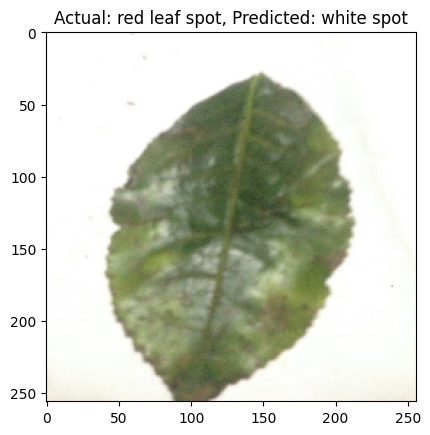

1/1 [==============================] - 0s 103ms/step


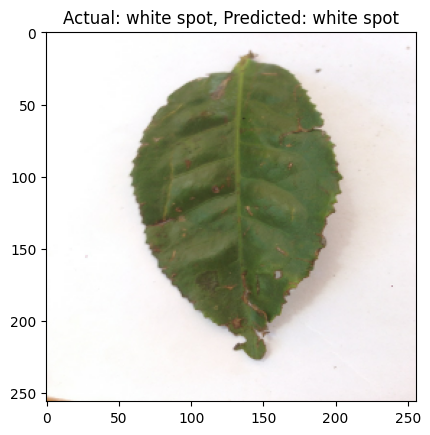

1/1 [==============================] - 0s 104ms/step


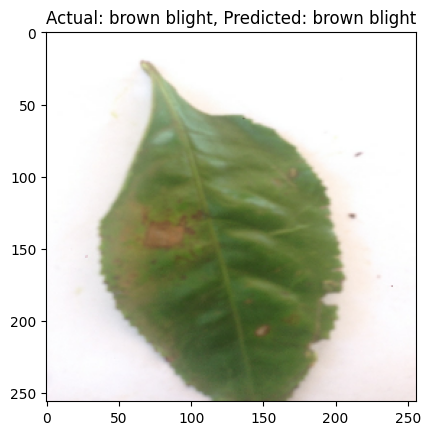

1/1 [==============================] - 0s 104ms/step


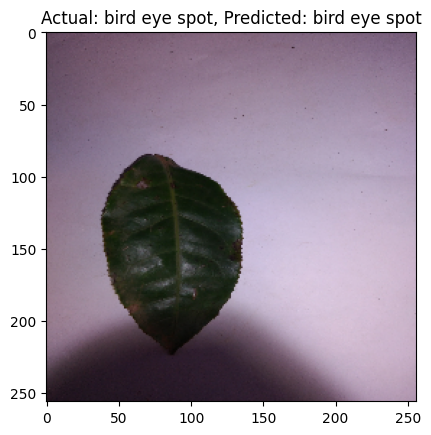

1/1 [==============================] - 0s 130ms/step


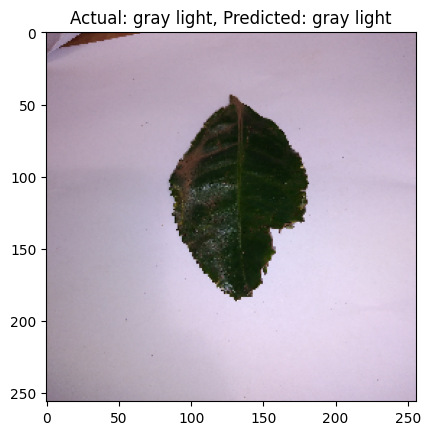

1/1 [==============================] - 0s 101ms/step


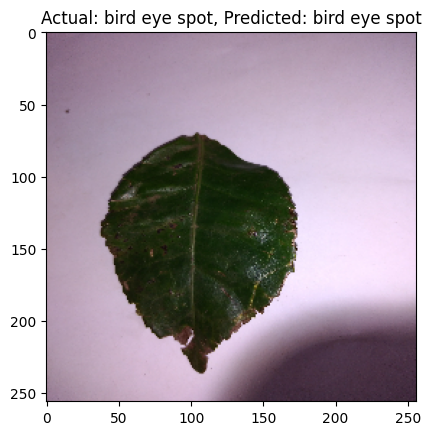

1/1 [==============================] - 0s 108ms/step


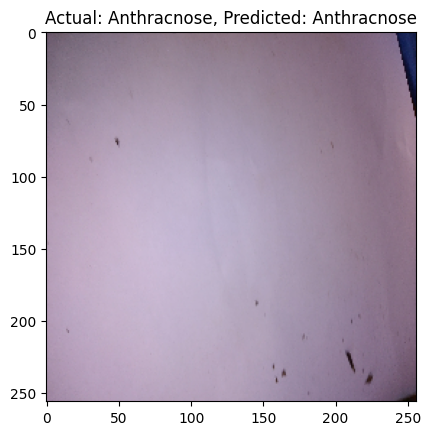

1/1 [==============================] - 0s 117ms/step


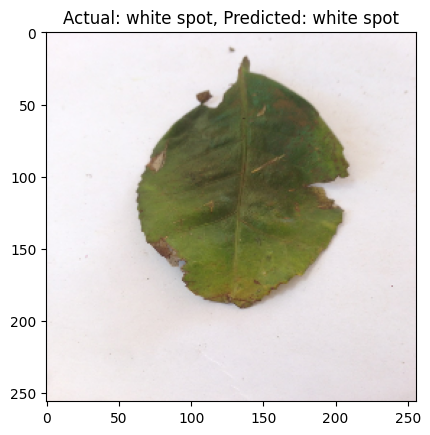

1/1 [==============================] - 0s 107ms/step


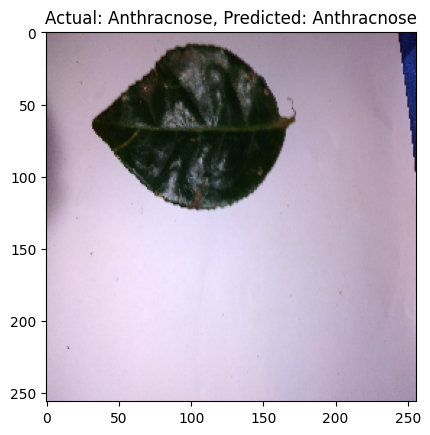

1/1 [==============================] - 0s 106ms/step


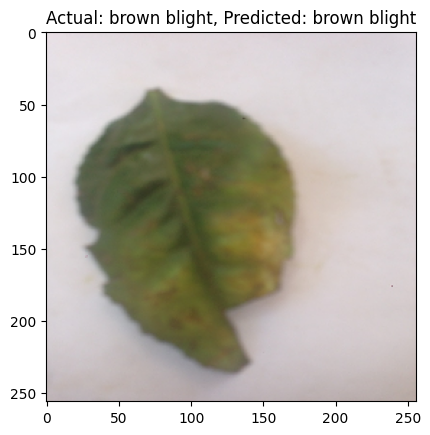

1/1 [==============================] - 0s 134ms/step


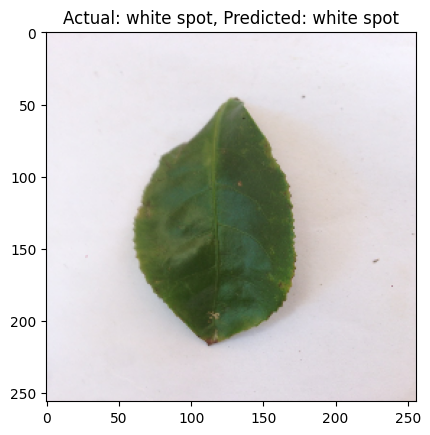

1/1 [==============================] - 0s 106ms/step


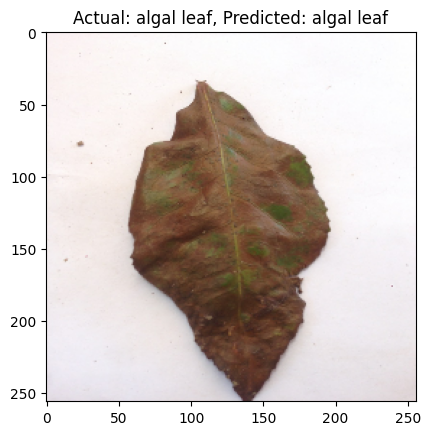

1/1 [==============================] - 0s 144ms/step


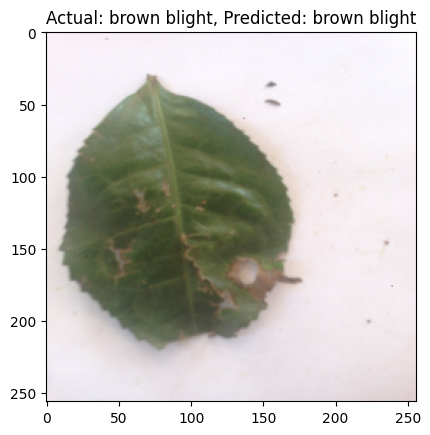

1/1 [==============================] - 0s 146ms/step


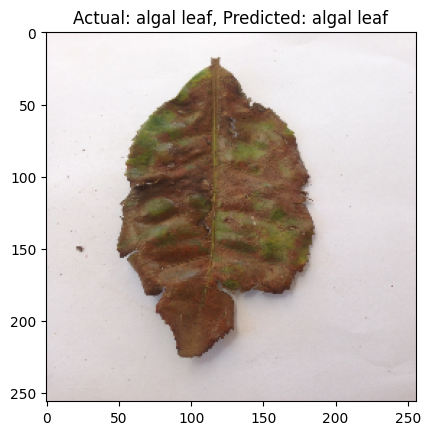

1/1 [==============================] - 0s 148ms/step


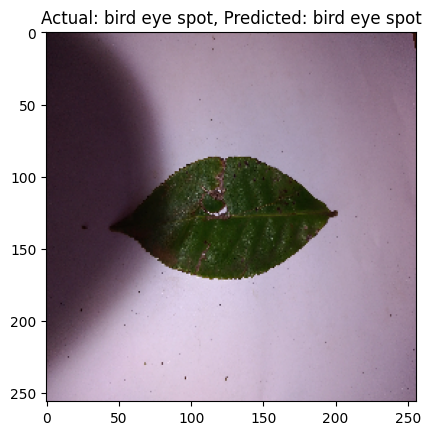

1/1 [==============================] - 0s 152ms/step


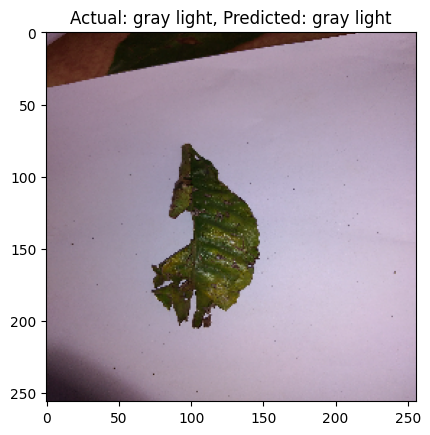

1/1 [==============================] - 0s 104ms/step


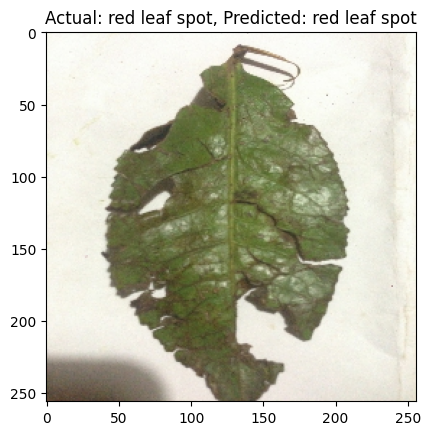

1/1 [==============================] - 0s 105ms/step


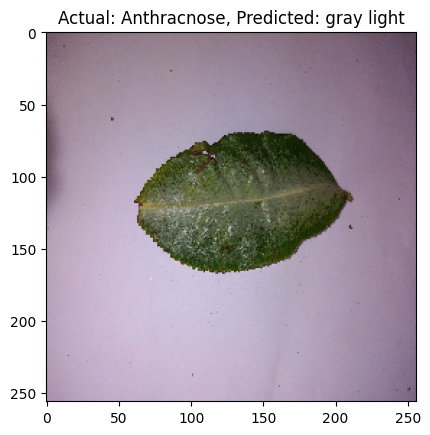

1/1 [==============================] - 0s 105ms/step


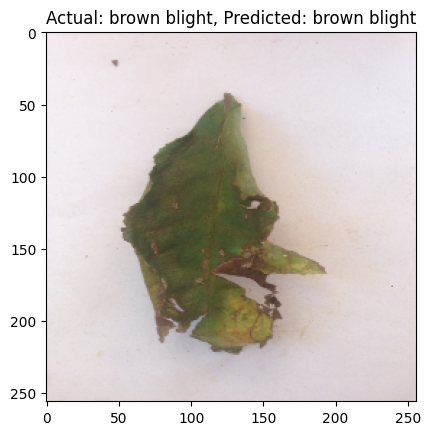

1/1 [==============================] - 0s 102ms/step


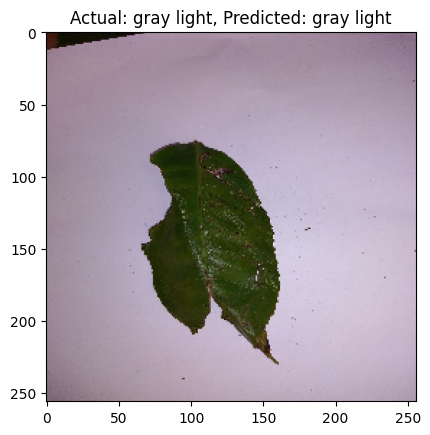

1/1 [==============================] - 0s 104ms/step


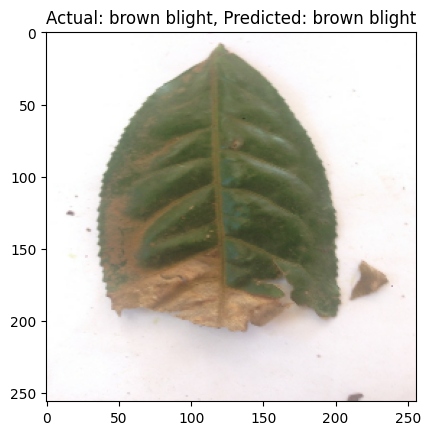

1/1 [==============================] - 0s 100ms/step


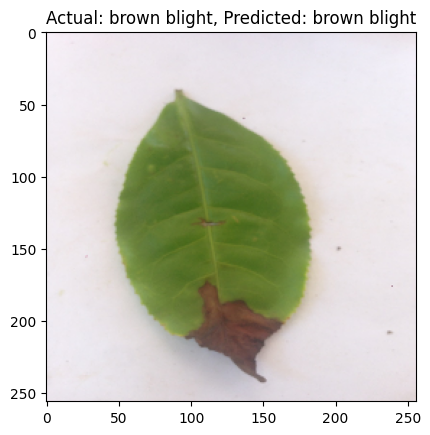

1/1 [==============================] - 0s 111ms/step


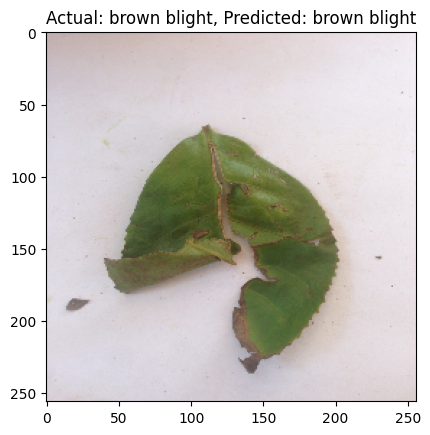

1/1 [==============================] - 0s 113ms/step


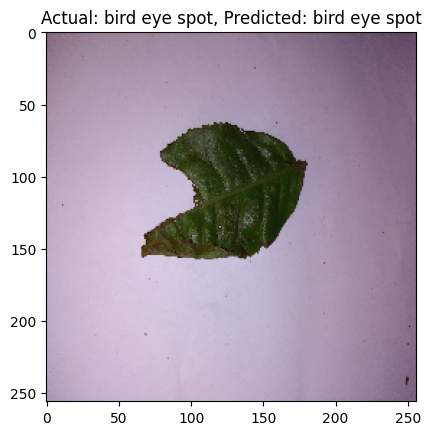

1/1 [==============================] - 0s 106ms/step


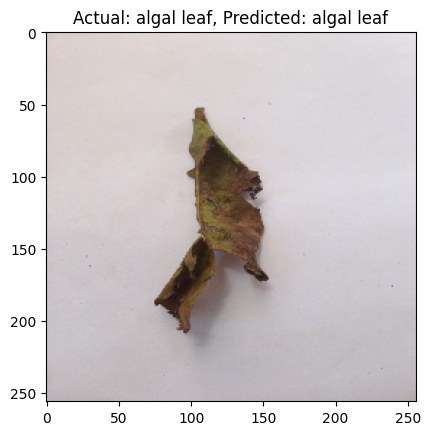

1/1 [==============================] - 0s 110ms/step


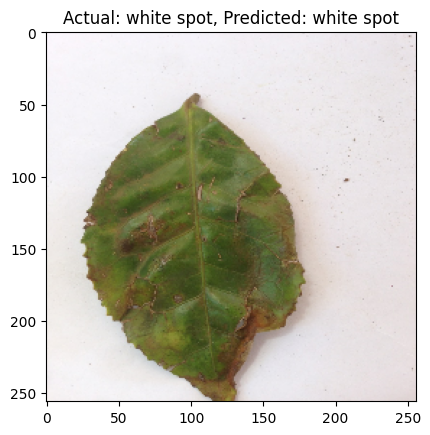

1/1 [==============================] - 0s 104ms/step


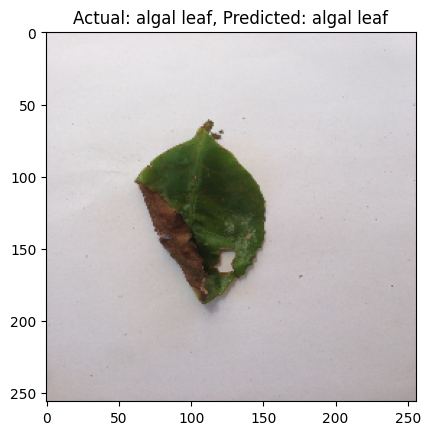

1/1 [==============================] - 0s 128ms/step


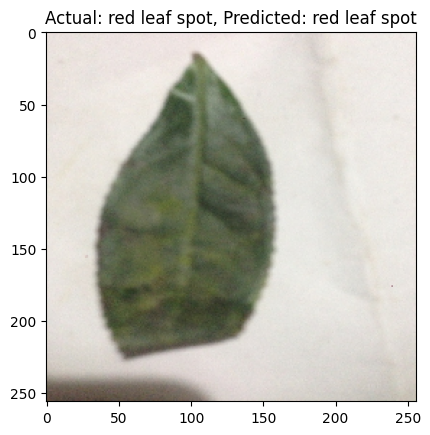

1/1 [==============================] - 0s 103ms/step


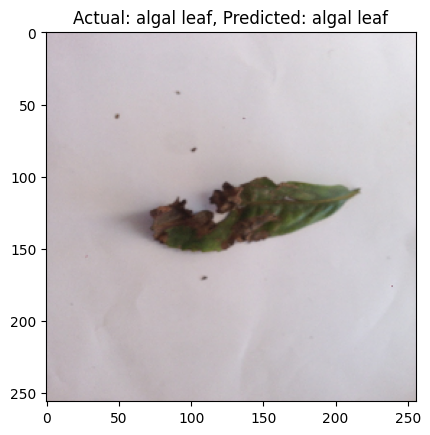

1/1 [==============================] - 0s 102ms/step


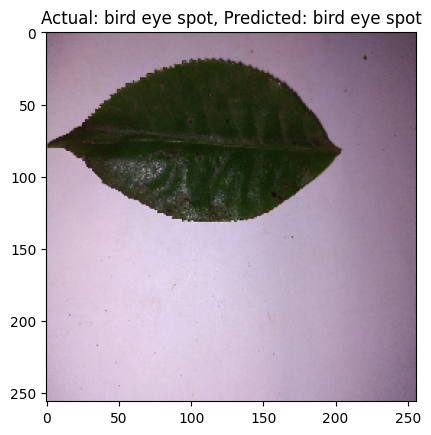

1/1 [==============================] - 0s 127ms/step


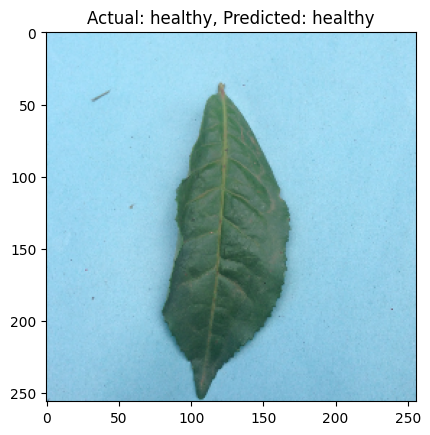

1/1 [==============================] - 0s 144ms/step


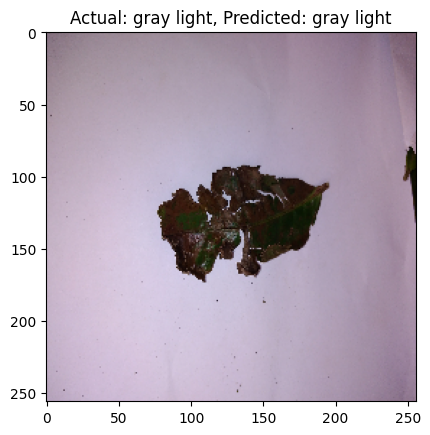

1/1 [==============================] - 0s 144ms/step


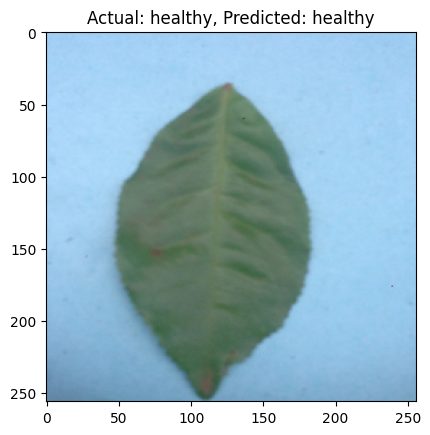

1/1 [==============================] - 0s 149ms/step


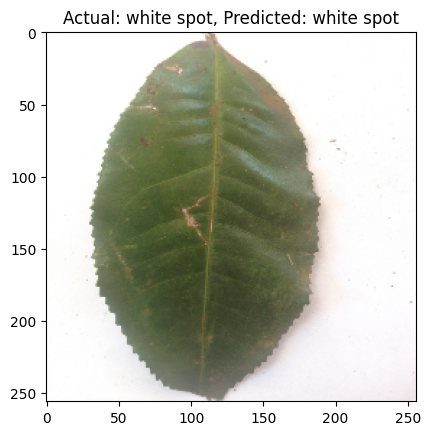

1/1 [==============================] - 0s 125ms/step


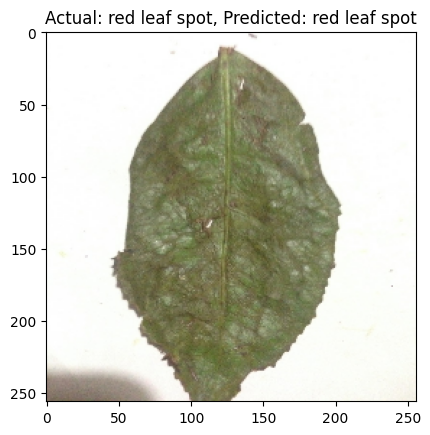

1/1 [==============================] - 0s 166ms/step


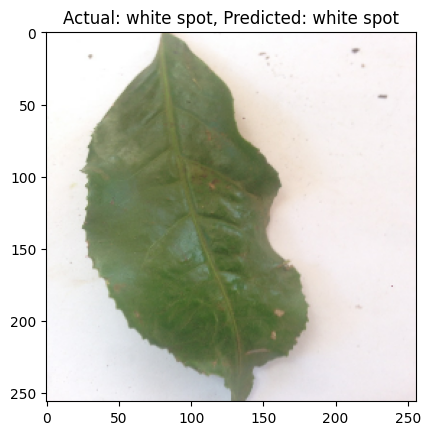

1/1 [==============================] - 0s 133ms/step


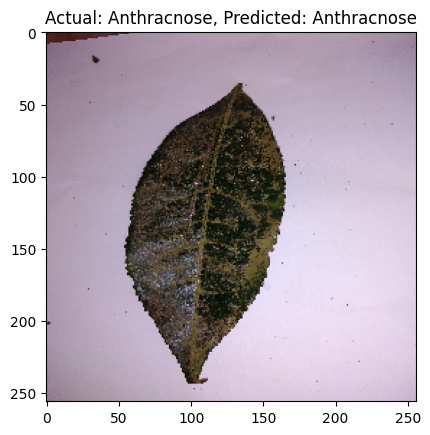

1/1 [==============================] - 0s 121ms/step


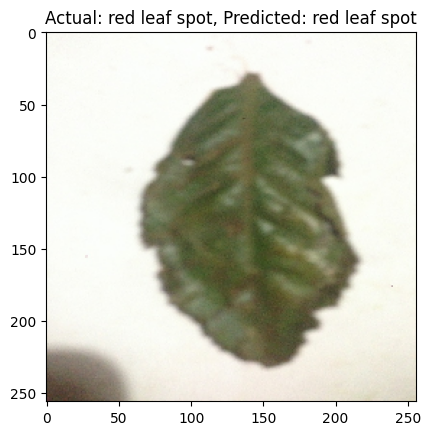

1/1 [==============================] - 0s 113ms/step


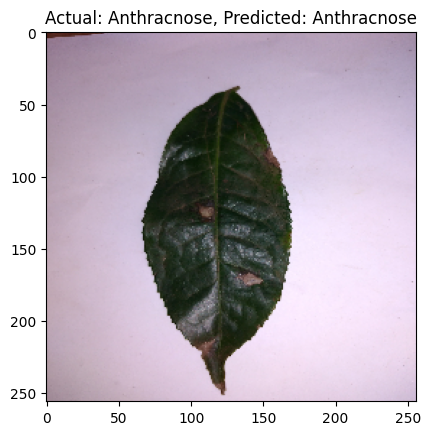

1/1 [==============================] - 0s 152ms/step


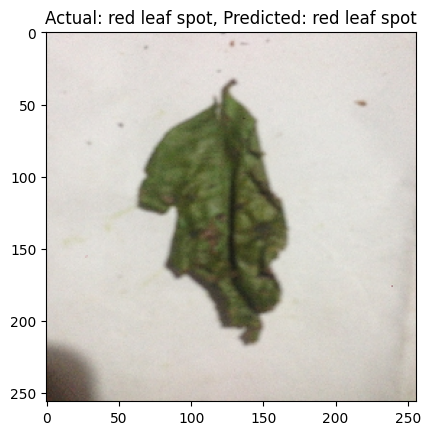

1/1 [==============================] - 0s 103ms/step


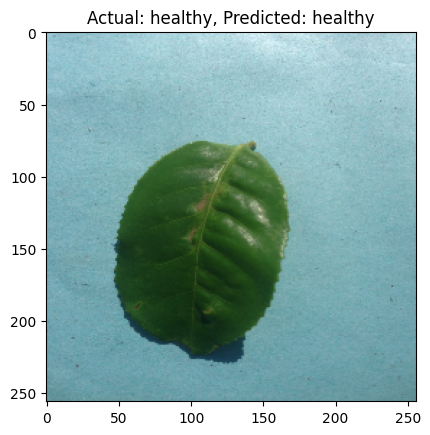

1/1 [==============================] - 0s 103ms/step


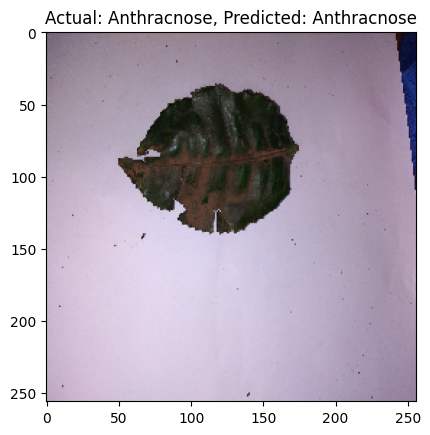

1/1 [==============================] - 0s 105ms/step


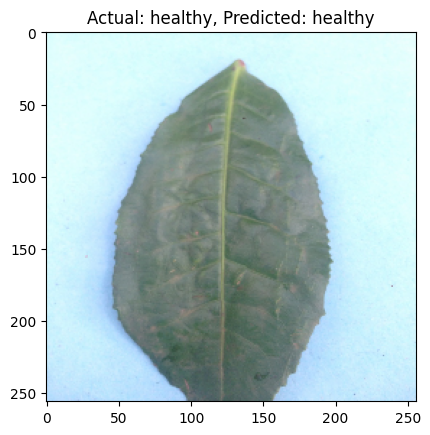

1/1 [==============================] - 0s 128ms/step


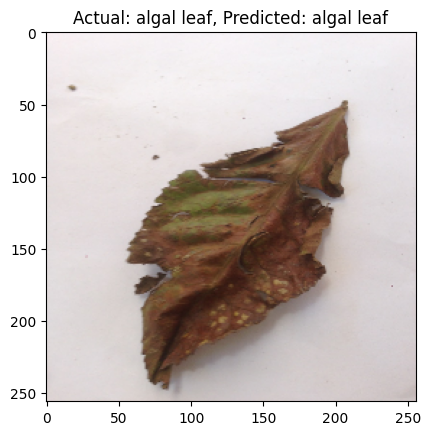

1/1 [==============================] - 0s 102ms/step


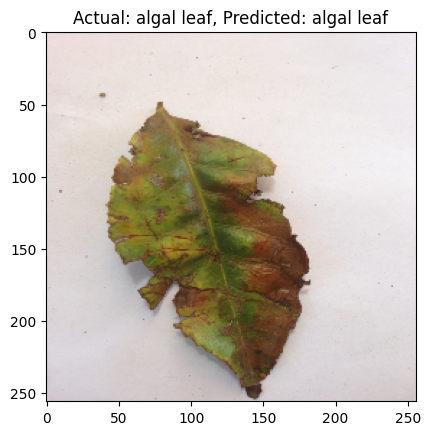

1/1 [==============================] - 0s 102ms/step


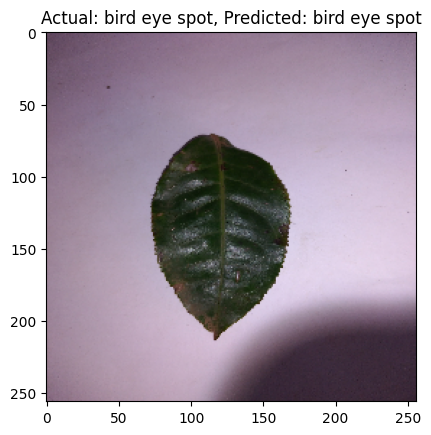

1/1 [==============================] - 0s 103ms/step


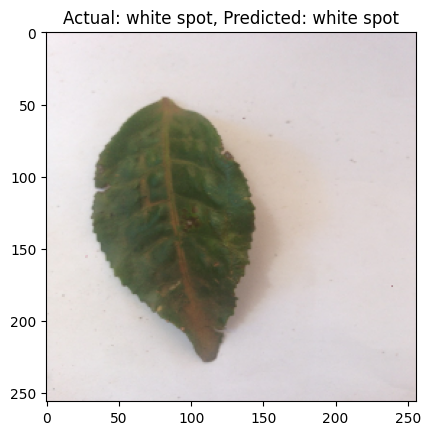

1/1 [==============================] - 0s 101ms/step


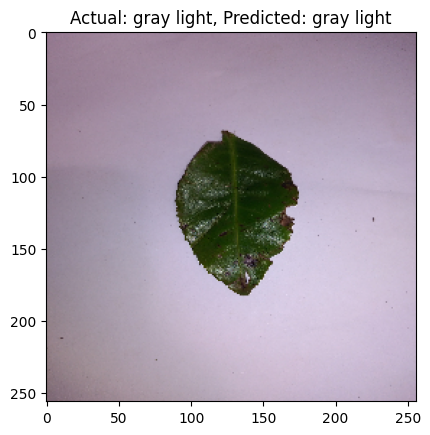

1/1 [==============================] - 0s 104ms/step


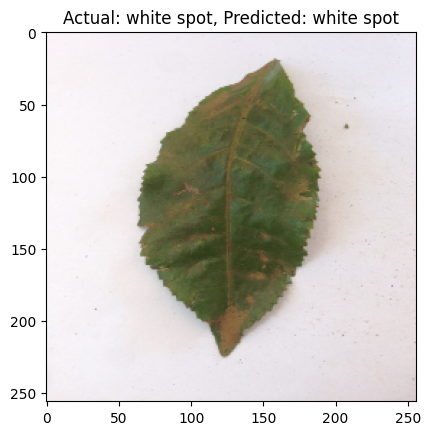

1/1 [==============================] - 0s 101ms/step


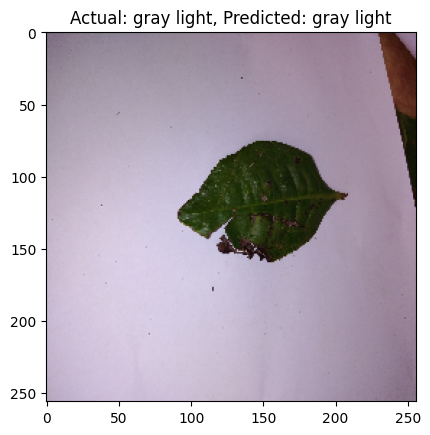

1/1 [==============================] - 0s 104ms/step


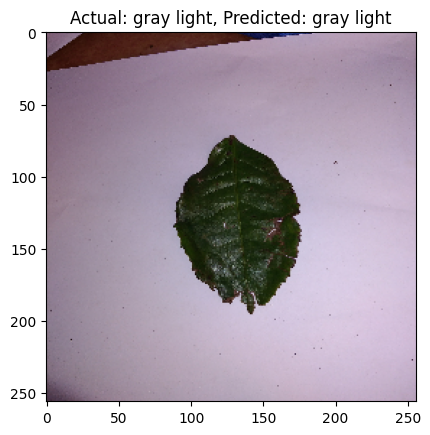

1/1 [==============================] - 0s 111ms/step


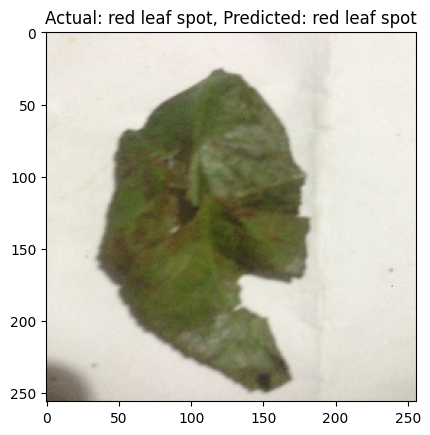

1/1 [==============================] - 0s 102ms/step


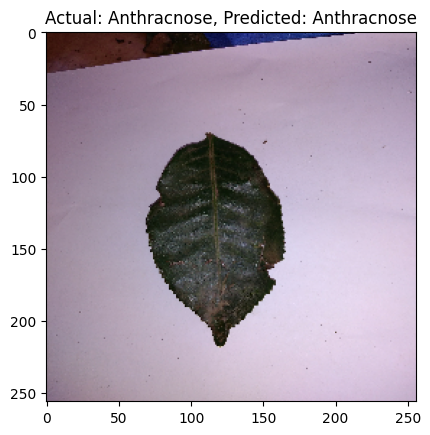

1/1 [==============================] - 0s 104ms/step


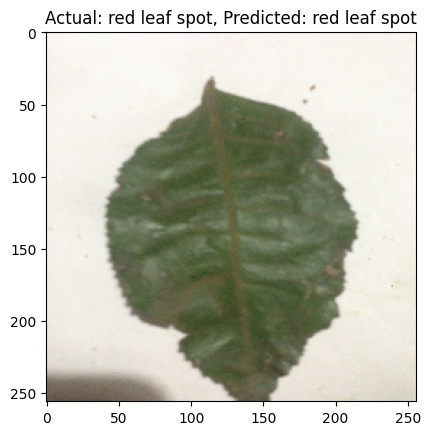

1/1 [==============================] - 0s 106ms/step


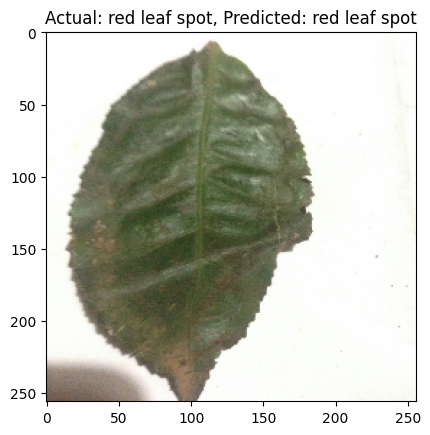

1/1 [==============================] - 0s 141ms/step


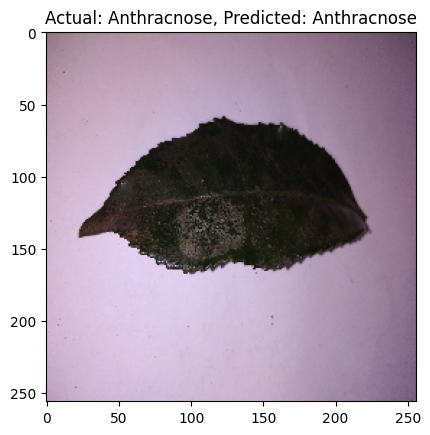

1/1 [==============================] - 0s 142ms/step


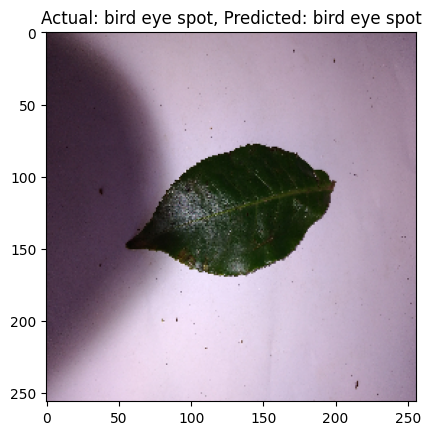

1/1 [==============================] - 0s 124ms/step


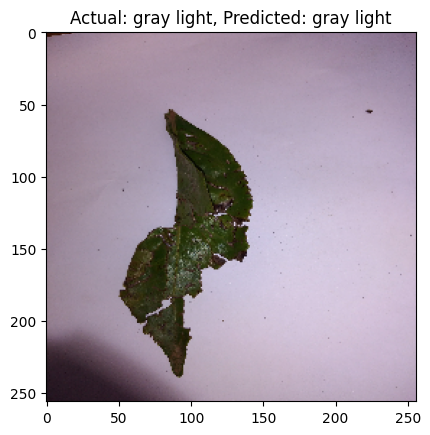

1/1 [==============================] - 0s 124ms/step


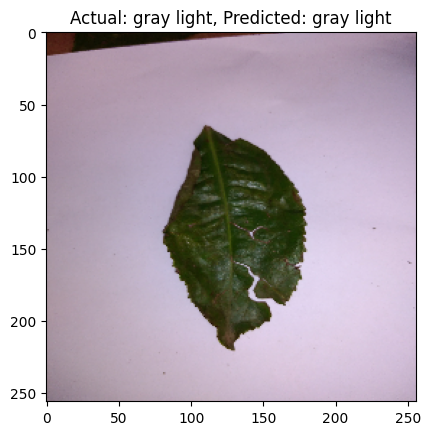

1/1 [==============================] - 0s 172ms/step


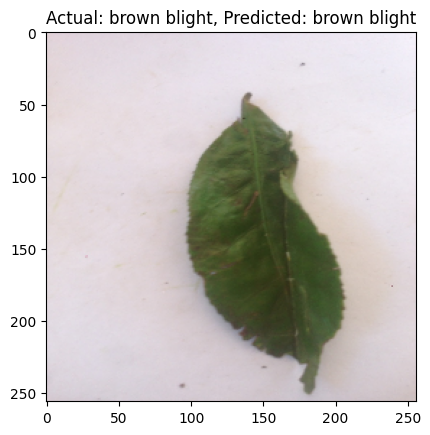

1/1 [==============================] - 0s 110ms/step


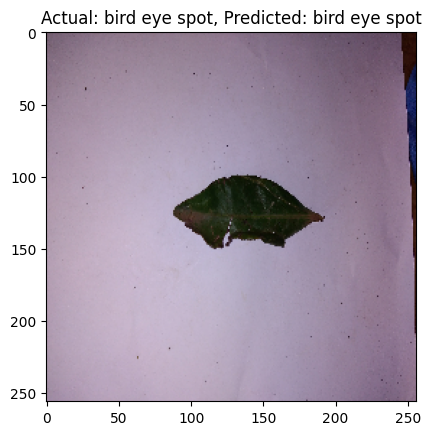

1/1 [==============================] - 0s 130ms/step


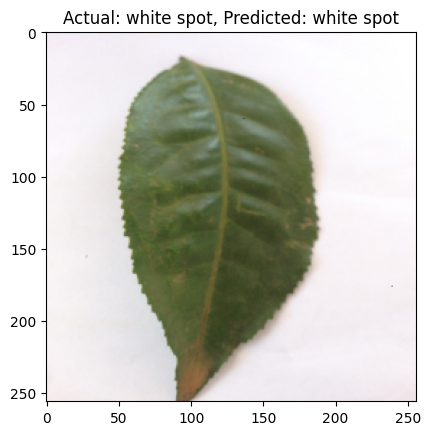

1/1 [==============================] - 0s 107ms/step


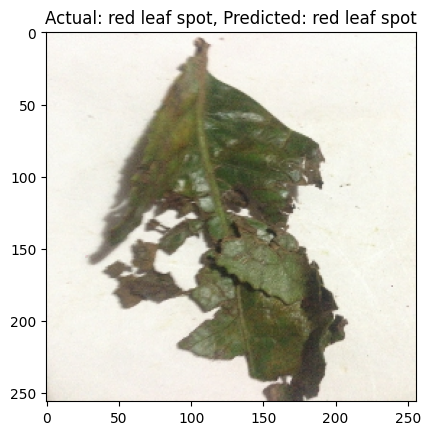

1/1 [==============================] - 0s 190ms/step


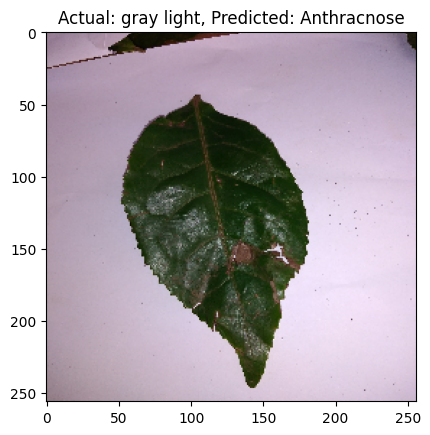

1/1 [==============================] - 0s 125ms/step


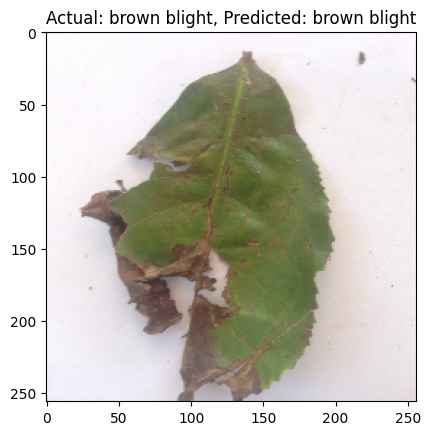

1/1 [==============================] - 0s 119ms/step


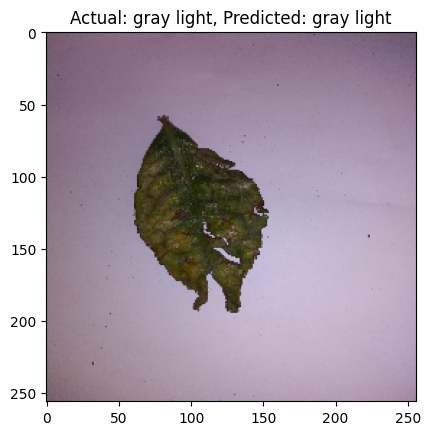

1/1 [==============================] - 0s 106ms/step


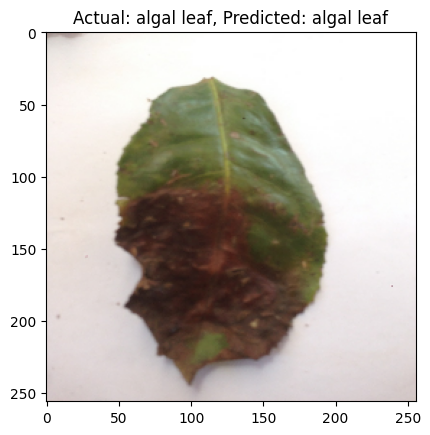

In [ ]:
visualize_predictions(test_ds, loaded_model)

# **Getting classification report**

1/1 [==============================] - 0s 68ms/step


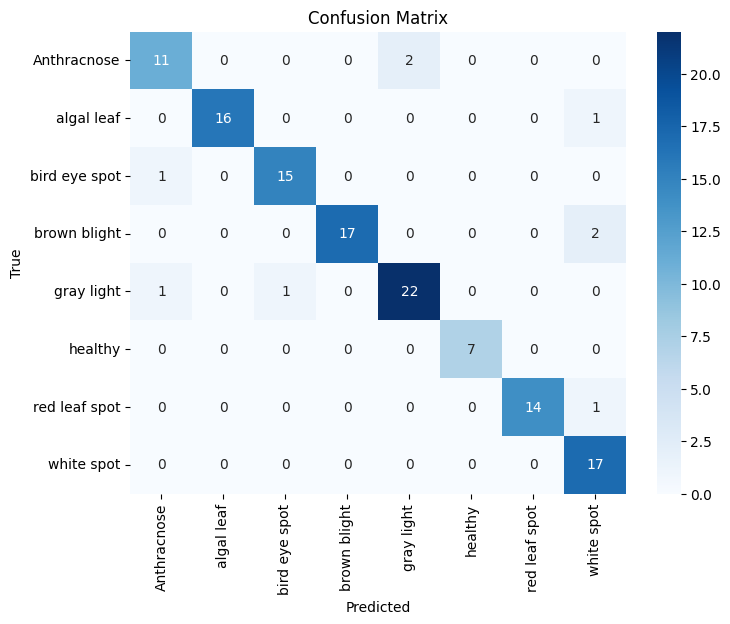

Classification Report:
                precision    recall  f1-score   support

  Anthracnose       0.85      0.85      0.85        13
   algal leaf       1.00      0.94      0.97        17
bird eye spot       0.94      0.94      0.94        16
 brown blight       1.00      0.89      0.94        19
   gray light       0.92      0.92      0.92        24
      healthy       1.00      1.00      1.00         7
red leaf spot       1.00      0.93      0.97        15
   white spot       0.81      1.00      0.89        17

     accuracy                           0.93       128
    macro avg       0.94      0.93      0.93       128
 weighted avg       0.94      0.93      0.93       128



In [ ]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming you have a test dataset, replace `test_ds` with your actual test dataset
# Get predictions from the model
predictions = []
true_labels = []

for images_batch, labels_batch in test_ds:
    for i in range(len(images_batch)):
        image = images_batch[i]
        label = labels_batch[i].numpy()

        # Reshape the image to (1, height, width, channels) for prediction
        image_for_prediction = tf.expand_dims(image, axis=0)

        # Make predictions
        predictions_batch = loaded_model.predict(image_for_prediction)
        predicted_label = np.argmax(predictions_batch[0])

        predictions.append(predicted_label)
        true_labels.append(label)

# Create confusion matrix
cm = confusion_matrix(true_labels, predictions)

# Visualize the confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='g', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(true_labels, predictions, target_names=class_names))


In [ ]:
import numpy as np
from sklearn.model_selection import KFold

# Define the number of folds
k_folds = 5

# Initialize lists to store results
accuracies = []
losses = []

# Initialize KFold object
kf = KFold(n_splits=k_folds)

# Convert datasets to numpy arrays
X_train = np.concatenate([X for X, _ in train_ds], axis=0)
y_train = np.concatenate([y for _, y in train_ds], axis=0)

# Perform k-fold cross-validation
for train_index, val_index in kf.split(X_train):
    # Split the data
    X_train_fold, X_val_fold = X_train[train_index], X_train[val_index]
    y_train_fold, y_val_fold = y_train[train_index], y_train[val_index]

    # Build and compile your model (replace this with your pre-loaded model)
    loaded_model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

    # Train the model
    history = loaded_model.fit(X_train_fold, y_train_fold, epochs=10, validation_data=(X_val_fold, y_val_fold))

    # Evaluate the model on validation data
    loss, accuracy = loaded_model.evaluate(X_val_fold, y_val_fold)
    losses.append(loss)
    accuracies.append(accuracy)

# Calculate and print the mean and standard deviation of accuracy and loss
print("Mean accuracy:", np.mean(accuracies))
print("Standard deviation of accuracy:", np.std(accuracies))
print("Mean loss:", np.mean(losses))
print("Standard deviation of loss:", np.std(losses))


Epoch 1/10
18/18 [==============================] - 137s 7s/step - loss: 3.4408 - accuracy: 0.0973 - val_loss: 8.3302 - val_accuracy: 0.1007
Epoch 2/10
18/18 [==============================] - 131s 7s/step - loss: 2.4313 - accuracy: 0.1550 - val_loss: 6.7754 - val_accuracy: 0.1583
Epoch 3/10
18/18 [==============================] - 127s 7s/step - loss: 2.1907 - accuracy: 0.2036 - val_loss: 6.7494 - val_accuracy: 0.1511
Epoch 4/10
18/18 [==============================] - 125s 7s/step - loss: 2.1073 - accuracy: 0.2216 - val_loss: 6.3568 - val_accuracy: 0.1799
Epoch 5/10
18/18 [==============================] - 127s 7s/step - loss: 2.1018 - accuracy: 0.2288 - val_loss: 4.9189 - val_accuracy: 0.1511
Epoch 6/10
18/18 [==============================] - 136s 8s/step - loss: 1.9197 - accuracy: 0.2901 - val_loss: 3.8200 - val_accuracy: 0.1439
Epoch 7/10
18/18 [==============================] - 128s 7s/step - loss: 1.7281 - accuracy: 0.3874 - val_loss: 2.6805 - val_accuracy: 0.1079
Epoch 8/10
18

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential


# Get the input shape from the first layer of the loaded model
input_shape = loaded_model.layers[0].input_shape[1:]

# Manually define a new Keras model with the same architecture
keras_model = Sequential()

# Set the input shape for the first layer
keras_model.add(tf.keras.layers.Input(shape=input_shape))

# Add the rest of the layers from the loaded model
for layer in loaded_model.layers[1:]:
    keras_model.add(layer)

# Save the Keras model to a .h5 file
keras_model.save('/content/drive/MyDrive/colab_NoteBooks/converted_model.h5')


ValueError: Exception encountered when calling layer "batch_normalization_12" (type BatchNormalization).

Dimensions must be equal, but are 3 and 32 for '{{node batch_normalization_12/FusedBatchNormV3}} = FusedBatchNormV3[T=DT_FLOAT, U=DT_FLOAT, data_format="NHWC", epsilon=0.001, exponential_avg_factor=1, is_training=false](Placeholder, batch_normalization_12/ReadVariableOp, batch_normalization_12/ReadVariableOp_1, batch_normalization_12/FusedBatchNormV3/ReadVariableOp, batch_normalization_12/FusedBatchNormV3/ReadVariableOp_1)' with input shapes: [?,256,256,3], [32], [32], [32], [32].

Call arguments received by layer "batch_normalization_12" (type BatchNormalization):
  • inputs=tf.Tensor(shape=(None, 256, 256, 3), dtype=float32)
  • training=None
  • mask=None